# Training Custom ResNet
___

## Table of contents
1. [Imports](#Imports)
2. [LoadData](#LoadData)
3. [Config](#Configs)
4. [Analysis](#Analysis)
5. [Process](#Process)

## Imports

In [1]:
import os
import numpy as np
import pandas as pd

import optuna
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

from torch.utils.data import Dataset,DataLoader,random_split
from torch.utils.tensorboard import SummaryWriter
import torchvision
from torchvision import models, transforms
from torch_lr_finder import LRFinder

from tqdm.notebook import tqdm

import math
import pretrainedmodels as ptm
import h5py
import copy
from datetime import datetime
import matplotlib.pyplot as plt

In [2]:
from Library.datasets import DatasetH5TwoRandom, DatasetH5ForTest, compute_std_mean
from Library.transforms import RandomFlip,RandomOffset,RandomRotateGrayscale
from Library.scheduler import OneCycleLR,LogLR
from Library.cresnet import initialize_cresnet
from Library.dml import RefBasedDeepMetric
from Library.models.FeatureExtractor import FeatureExtractor, Block, CustomNet
from Library.trainers import RefBasedDeepMetricTrainer

In [3]:
from Library.util import (
    jupyter_wide_screen,
    strings_contain_words, 
    strings_contain_patterns, 
    add_unique_entry
)

jupyter_wide_screen()

## LoadData

#### To initialize dataset: obtain References and Dataset object

In [4]:
#### To initialize dataset: obtain References and Dataset object
def init_dataset(path,seq_idx_list,mean_val,std_val):

    ds_h5 = []
    refs_list = []
    
    ### 可能还需要用 transforms.RandomHorizontalFlip()  RandomRotate
    #img_transforms = [transforms.ToTensor(),transforms.Normalize((mean_val,),(std_val,))] # 先标准化处理
    img_transforms = [RandomRotateGrayscale(rot_range=[-0.1, 0.1], fill=150),
                      RandomFlip(lr_prob=0.5, ud_prob=0.5),
                      transforms.ToTensor(),
                      transforms.Normalize((mean_val,),(std_val,))]
    
    composed_img_transforms = transforms.Compose(img_transforms)
    
    # to obtain the Seq data
    for seq_idx in seq_idx_list:
        h5_fpath = path.format(seq_idx)
        h5_f = DatasetH5TwoRandom(h5_fpath,transform = composed_img_transforms)
        
        # obtain the references, the first 10 images in every Seq.
        refs = h5_f.getRef()
        refs_list.append(refs)
        
        ds_h5.append(h5_f)

    return refs_list, ds_h5

In [6]:
# 3 stripes
data_path_type1 = "../MA/NewData/22008_1000202026_652510007"
fnames_type1 = "Padding_regenerated_roi_ms1_seq{}_720x24.h5"
combined_path_type1 = os.path.join(data_path_type1, fnames_type1)
seq_idx_list_type1 = [0,1,2,3,4,5,6]

In [7]:
# 1 stripe
data_path_type2 = "../MA/NewData/21503_1000200411_653340003"
fnames_type2 = "trueroi_filtered_phase2_1_{}.h5" # 2,3,4
combined_path_type2 = os.path.join(data_path_type2, fnames_type2)
seq_idx_list_type2 = [2,3,4]

inputs_shape = [1,720,24]
batch_sizes = [32, 32, 32]
shuffle_flags = [True, False, False]
ds_ratio = [0.6, 0.2, 0.2]

In [9]:
mean_val = 0
std_val = 255
refs_list, ds_h5 = init_dataset(combined_path_type1, seq_idx_list_type1, mean_val, std_val)

In [10]:
len(refs_list)

7

In [11]:
refs_list_2, ds_h5_2 = init_dataset(combined_path_type2, seq_idx_list_type2, mean_val, std_val)

In [12]:
len(refs_list_2)

3

In [13]:
refs_list.insert(1,refs_list_2[0])
refs_list.insert(3,refs_list_2[1])
refs_list.insert(5,refs_list_2[2])


ds_h5.insert(1,ds_h5_2[0])
ds_h5.insert(3,ds_h5_2[1])
ds_h5.insert(5,ds_h5_2[2])

#### Dataloader for training set ,validation set, test set (60%,20%,20%)

In [5]:
def init_dataloaders(datasets,ds_ratio):
    dataloaders = []
    
    for ds in datasets:
        splitted_ds_num_data = [round(len(ds) * ds_ratio[i]) for i in range(len(ds_ratio))]
        splitted_ds_num_data[0] += len(ds) - int(np.sum(splitted_ds_num_data))

        splitted_ds = []

        for tmp_ds, batch_size, shuffle in zip(random_split(ds, splitted_ds_num_data), batch_sizes, shuffle_flags):

            splitted_ds.append(
                DataLoader(
                    tmp_ds,
                    batch_size=batch_size,
                    shuffle=shuffle,
                    drop_last=True,
                )
            )

        dataloaders.append(splitted_ds)
    return dataloaders


In [14]:
dataloaders = init_dataloaders(ds_h5, ds_ratio)

train_dls = [dls[0] for dls in dataloaders]
valid_dls = [dls[1] for dls in dataloaders]
test_dls = [dls[2] for dls in dataloaders]

## FeatureExtractor

In [15]:
class FeatureExtractor(nn.Module):
    # Custom feature extraction model from pretrained ResNet50

    def __init__(self, model,zero_init_residual=False):
        super(FeatureExtractor, self).__init__()
        
        self.conv1= nn.Conv2d(1, 64, 3, (2,1), 1)
        self.bn1 = model.bn1
        #self.relu = nn.LeakyReLU(inplace = True)
        self.relu = model.relu
        self.maxpool = model.maxpool

        self.layer1 = model.layer1
        self.layer2 = model.layer2

        self.avgpool = nn.AdaptiveAvgPool2d((1,1))
        self.fc = nn.Sequential(nn.Linear(128, 64))
                
        # weights initialization
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode = 'fan_in', nonlinearity = 'leaky_relu')

        # Zero-initialize the last BN in each residual branch,
        # so that the residual branch starts with zeros, and each residual block behaves like an identity.
        # This improves the model by 0.2~0.3% according to https://arxiv.org/abs/1706.02677
        if zero_init_residual:
            for m in self.modules():
                if isinstance(m, Bottleneck):
                    nn.init.constant_(m.bn3.weight, 0)
                elif isinstance(m, BasicBlock):
                    nn.init.constant_(m.bn2.weight, 0)

    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        
        self.featuremap0 = x.detach() # 核心代码

        x = self.layer1(x)
        self.featuremap1 = x.detach() # 核心代码
        
        x = self.layer2(x)
        self.featuremap2 = x.detach() # 核心代码
        
        x = self.avgpool(x)
        x = x.reshape(x.shape[0], -1)

        x = self.fc(x)
        self.featuremapfc = x.detach() # 核心代码
        
        return x
    
    def show_intermediate_shape(self, x):
    
        x = self.conv1(x)
        print("In conv1: ", x.shape)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        print("In maxpool: ", x.shape)
        x = self.layer1(x)
        print("In layer1: ", x.shape)
        x = self.layer2(x)
        print("In layer2: ", x.shape)
        
        x = self.avgpool(x)
        x = x.reshape(x.shape[0], -1)
        x = self.fc(x)
        print("In FC: ", x.shape)

## SiameseNet structure

In [ ]:
class SiameseNet(nn.Module):
    def __init__(self, model):
        super(SiameseNet, self).__init__()
        self.model = model
        
    def _calculate_loss(self, v1, v2, refs_tensor):
        r"""Calculate distance between vector of img1&img2 and each reference images

        Args:
            v1 (Tensor, torch.Size[batchsize,128]): batch of img1s from feature extractor
            v2 (Tensor, torch.Size[batchsize,128]): batch of img2s from feature extractor
            refs_vectors(List of Tensor, torch.Size([1,128])): List of 10 refs vectors
        """
        v_dim = v1.size(1)
        num_ref = refs_tensor.size(0)

        v11 = v1.unsqueeze(1).repeat(1, num_ref, 1)
        v22 = v2.unsqueeze(1).repeat(1, num_ref, 1)
        refs = refs_tensor.unsqueeze(0).repeat(v1.size(0), 1, 1)  #v1.size(0) = batch size

        kernel_matrix1 = (v11-refs).pow(2).sum(2) #torch.Size([batchsize, 10])
        kernel_matrix2 = (v22-refs).pow(2).sum(2) #torch.Size([batchsize, 10])

        v1_distance_mean = torch.mean(kernel_matrix1,dim = 1) #torch.Size([batchsize])
        v2_distance_mean = torch.mean(kernel_matrix2,dim = 1) #torch.Size([batchsize])
        
        diff = v1_distance_mean - v2_distance_mean
        
        #print("Before Sigmoid outputs",outputs)
        sigmoid = nn.Sigmoid()
        outputs = sigmoid(diff)
        #print("After Sigmoid outputs",outputs)

        return outputs

    def forward(self, x1, x2, refs):
        v1 = self.model(x1)
        v2 = self.model(x2)
        feature_refs = self.model(refs)
        
        outputs = self._calculate_loss(v1, v2, feature_refs)
        return outputs
    
    # This function used to plot the degradation metric , x1 is the sequential image
    def forward_test(self, x1, refs):
        v1 = self.model(x1)
        feature_refs = self.model(refs)
        
        return v1, feature_refs
    
    def get_model(self, x):
        return self.model(x)


#### Load pretrained ResNet

In [16]:
res_model = models.resnet34(pretrained=True)
feature_extractor = FeatureExtractor(res_model)
model = RefBasedDeepMetric(feature_extractor,loss_non_linearity_name='sigmoid',criterion_name='bce',)
#model = SiameseNet(feature_extractor)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

RefBasedDeepMetric(
  (feature_extractor): FeatureExtractor(
    (conv1): Conv2d(1, 64, kernel_size=(3, 3), stride=(2, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, aff

In [17]:
inputs = torch.randn(1,1,720,24)
model.feature_extractor.show_intermediate_shape(inputs.to(device))

In conv1:  torch.Size([1, 64, 360, 24])
In maxpool:  torch.Size([1, 64, 180, 12])
In layer1:  torch.Size([1, 64, 180, 12])
In layer2:  torch.Size([1, 128, 90, 6])
In FC:  torch.Size([1, 64])


## Learning Rate Test

In [18]:
from torch.optim.lr_scheduler import _LRScheduler
from torch_lr_finder import LRFinder ,TrainDataLoaderIter, ValDataLoaderIter

In [19]:
class CustomTrainIter(TrainDataLoaderIter):
    def inputs_labels_from_batch(self, batch_data):
        img1, img2, labels = batch_data
        return img1, img2, labels
    
    def __next__(self):
        try:
            batch = next(self._iterator)
            img1, img2, labels = self.inputs_labels_from_batch(batch)
        except StopIteration:
            if not self.auto_reset:
                raise
            self._iterator = iter(self.data_loader)
            batch = next(self._iterator)
            img1, img2, labels = self.inputs_labels_from_batch(batch)

        return img1, img2, labels

In [20]:
class CustomValIter(ValDataLoaderIter):
    def inputs_labels_from_batch(self, batch_data):
        img1, img2, labels = batch_data
        return img1, img2, labels

In [21]:
class LinearLR(_LRScheduler):
    """Linearly increases the learning rate between two boundaries over a number of
    iterations.

    Arguments:
        optimizer (torch.optim.Optimizer): wrapped optimizer.
        end_lr (float): the final learning rate.
        num_iter (int): the number of iterations over which the test occurs.
        last_epoch (int, optional): the index of last epoch. Default: -1.
    """

    def __init__(self, optimizer, end_lr, num_iter, last_epoch=-1):
        self.end_lr = end_lr

        if num_iter <= 1:
            raise ValueError("`num_iter` must be larger than 1")
        self.num_iter = num_iter

        super(LinearLR, self).__init__(optimizer, last_epoch)

    def get_lr(self):
        r = self.last_epoch / (self.num_iter - 1)

        return [base_lr + r * (self.end_lr - base_lr) for base_lr in self.base_lrs]

In [22]:
class ExponentialLR(_LRScheduler):
    """Exponentially increases the learning rate between two boundaries over a number of
    iterations.

    Arguments:
        optimizer (torch.optim.Optimizer): wrapped optimizer.
        end_lr (float): the final learning rate.
        num_iter (int): the number of iterations over which the test occurs.
        last_epoch (int, optional): the index of last epoch. Default: -1.
    """

    def __init__(self, optimizer, end_lr, num_iter, last_epoch=-1):
        self.end_lr = end_lr

        if num_iter <= 1:
            raise ValueError("`num_iter` must be larger than 1")
        self.num_iter = num_iter

        super(ExponentialLR, self).__init__(optimizer, last_epoch)

    def get_lr(self):
        # In earlier Pytorch versions last_epoch starts at -1, while in recent versions
        # it starts at 0. We need to adjust the math a bit to handle this. See
        # discussion at: https://github.com/davidtvs/pytorch-lr-finder/pull/42
        
        r = self.last_epoch / (self.num_iter - 1)

        return [base_lr * (self.end_lr / base_lr) ** r for base_lr in self.base_lrs]

In [23]:
try:
    from apex import amp

    IS_AMP_AVAILABLE = True
except ImportError:
    IS_AMP_AVAILABLE = False
    
class CustomLRFinder(LRFinder):
    
    def custom_range_test(
        self,
        train_loader,
        curr_refs,
        val_loader=None,
        start_lr=None,
        end_lr=10,
        num_iter=100,
        step_mode="exp",
        smooth_f=0.05,
        diverge_th=5,
        accumulation_steps=1,
        non_blocking_transfer=True,
    ):
       
        # Reset test results
        self.history = {"lr": [], "loss": []}
        self.best_loss = None

        # Move the model to the proper device
        self.model.to(self.device)

        # Check if the optimizer is already attached to a scheduler
        self._check_for_scheduler()

        # Set the starting learning rate
        if start_lr:
            self._set_learning_rate(start_lr)

        # Initialize the proper learning rate policy
        if step_mode.lower() == "exp":
            lr_schedule = ExponentialLR(self.optimizer, end_lr, num_iter)
        elif step_mode.lower() == "linear":
            lr_schedule = LinearLR(self.optimizer, end_lr, num_iter)
        else:
            raise ValueError("expected one of (exp, linear), got {}".format(step_mode))

        if smooth_f < 0 or smooth_f >= 1:
            raise ValueError("smooth_f is outside the range [0, 1[")

        # Create an iterator to get data batch by batch
        if isinstance(train_loader, DataLoader):
            train_iter = TrainDataLoaderIter(train_loader)
        elif isinstance(train_loader, TrainDataLoaderIter):
            train_iter = train_loader
        else:
            raise ValueError(
                "`train_loader` has unsupported type: {}."
                "Expected types are `torch.utils.data.DataLoader`"
                "or child of `TrainDataLoaderIter`.".format(type(train_loader))
            )

        if val_loader:
            if isinstance(val_loader, DataLoader):
                val_iter = CustomValIter(val_loader)
            elif isinstance(val_loader, ValDataLoaderIter):
                val_iter = val_loader
            else:
                raise ValueError(
                    "`val_loader` has unsupported type: {}."
                    "Expected types are `torch.utils.data.DataLoader`"
                    "or child of `ValDataLoaderIter`.".format(type(val_loader))
                )

        for iteration in tqdm(range(num_iter)):
            # Train on batch and retrieve loss
            loss = self._train_batch(
                train_iter,
                curr_refs,
                accumulation_steps,
                non_blocking_transfer= non_blocking_transfer,
            )
            if val_loader:
                loss = self._validate(
                    val_iter, curr_refs, non_blocking_transfer=non_blocking_transfer
                )

            # Update the learning rate
            self.history["lr"].append(lr_schedule.get_lr()[0])
            lr_schedule.step()

            # Track the best loss and smooth it if smooth_f is specified
            if iteration == 0:
                self.best_loss = loss
            else:
                if smooth_f > 0:
                    loss = smooth_f * loss + (1 - smooth_f) * self.history["loss"][-1]
                if loss < self.best_loss:
                    self.best_loss = loss

            # Check if the loss has diverged; if it has, stop the test
            self.history["loss"].append(loss)
            if loss > diverge_th * self.best_loss:
                print("Stopping early, the loss has diverged")
                break

        print("Learning rate search finished. See the graph with {finder_name}.plot()")

    def _train_batch(self, train_iter, curr_refs, accumulation_steps, non_blocking_transfer=True):
        self.model.train()
        total_loss = None  # for late initialization
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        self.optimizer.zero_grad()
        curr_refs = curr_refs.float().to(device)

        for i in range(accumulation_steps):
            img1, img2, labels = next(train_iter)
            labels = labels.view(-1)
            labels = labels.to(device)
            img1 = img1.float().to(device)
            img2 = img2.float().to(device)

            # Forward pass
            loss, preds = self.model.compute_loss(img1, img2, curr_refs, labels)

            # Loss should be averaged in each step
            loss /= accumulation_steps

            # Backward pass
            if IS_AMP_AVAILABLE and hasattr(self.optimizer, "_amp_stash"):
                # For minor performance optimization, see also:
                # https://nvidia.github.io/apex/advanced.html#gradient-accumulation-across-iterations
                delay_unscale = ((i + 1) % accumulation_steps) != 0

                with amp.scale_loss(
                    loss, self.optimizer, delay_unscale=delay_unscale
                ) as scaled_loss:
                    scaled_loss.backward()
            else:
                loss.backward()

            if total_loss is None:
                total_loss = loss
            else:
                total_loss += loss

        self.optimizer.step()

        return total_loss.item()
    
    def _validate(self, val_iter, curr_refs, non_blocking_transfer=True):
        # Set model to evaluation mode and disable gradient computation
        running_loss = 0
        self.model.eval()
        
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        curr_refs = curr_refs.float().to(device)
        with torch.no_grad():
            for img1, img2, labels in val_iter:
                # Move data to the correct device
                labels = labels.view(-1)
                labels = labels.to(device)
                img1 = img1.float().to(device)
                img2 = img2.float().to(device)

                # Forward pass and loss computation
                loss, preds = self.model.compute_loss(img1, img2, curr_refs, labels)
                running_loss += loss.item() * len(labels)

        return running_loss / len(val_iter.dataset)
    

### LR Test Config

In [24]:
start_lr = 1e-8
end_lr = 1e-1

min_lr_factor   = 0.2
anneal_lr_factor= 1e-1

train_dl_idx = 0
valid_dl_idx = 1
test_dl_idx = 2
refs_dl_idx = 0

optimizer = torch.optim.Adam(model.parameters(),lr=start_lr, eps=1e-08, weight_decay=0)
#optimizer = torch.optim.SGD(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, momentum=0.5)
#criterion = nn.CrossEntropyLoss()
#criterion = nn.BCEWithLogitsLoss(reduction = 'none')
criterion = nn.BCELoss()


Learning rate search finished. See the graph with {finder_name}.plot()


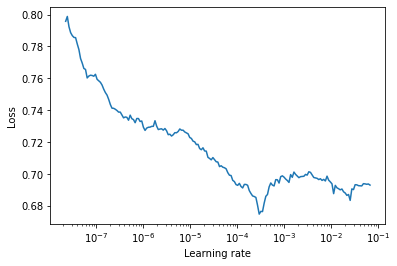

In [27]:
#lr_finder.reset()
lr_finder = CustomLRFinder(model, optimizer, criterion, device="cuda")

# seq dataloader / shuffel the dataloader
for refs, train_dl, val_dl in zip (refs_list, train_dls, valid_dls):
    custom_train_iter = CustomTrainIter(train_dl)
    custom_val_iter = CustomValIter(val_dl)
lr_finder.custom_range_test(custom_train_iter, curr_refs = refs, end_lr=end_lr, num_iter=200)
lr_finder.plot(suggest_lr= False)
lr_finder.reset()

## Training Config

In [28]:
num_epochs = 50

lr = 2e-4

min_lr_factor = 0.1
phases_ratio = [0.3, 0.2, 0.3, 0.2]

train_dl_idx = 0
valid_dl_idx = 1
test_dl_idx = 2

run_train = True

net_path = "../MA/save_net/"
criterion = nn.BCELoss()
def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']
    
dateTimeObj = datetime.now()
timestampStr = dateTimeObj.strftime("%d-%b-%Y (%H:%M:%S)")
print('Current Timestamp : ', timestampStr)

Current Timestamp :  26-May-2021 (01:22:01)


Total Train Iterations:  1127
Total Train Iterations List:  [37, 186, 231, 312, 439, 757, 839, 936, 1023, 1127]
Valid iterations per seq:  [12, 50, 15, 27, 42, 106, 27, 33, 29, 34]


Train



Sequence:1, Seq Training Mean Loss: 0.6954625554986902, Seq Training Acc: 0.527027027027027
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.6831209151536827, Seq Training Acc: 0.5952181208053692
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6781746930546231, Seq Training Acc: 0.5555555555555556
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.666272039030805, Seq Training Acc: 0.6033950617283951
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6955304342930712, Seq Training Acc: 0.5204232283464567
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.39495059702568835, Seq Training Acc: 0.8132861635220126
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.700589995558669, Seq Training Acc: 0.4851371951219512
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.6863920553443358, Seq Training Acc: 0.5367268041237113
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.68428886690359, Seq Training Acc: 0.5581896551724138
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.6458610193087504, Seq Training Acc: 0.6228966346153846
******************************************************************
Epoch:1, Epoch Training Loss Mean: 0.6004088521003723, Epoch Training Acc: 0.6317380212954747
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7669602086146673, Seq Valid Acc: 0.46875



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.0310873699188232, Seq Valid Acc: 0.553125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5910245935122173, Seq Valid Acc: 0.6833333333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.1389876184640106, Seq Valid Acc: 0.5196759259259259



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7187339507398152, Seq Valid Acc: 0.5379464285714286



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.4166762244026616, Seq Valid Acc: 0.5241745283018868



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7365733605844004, Seq Valid Acc: 0.47337962962962965



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6970847483837244, Seq Valid Acc: 0.5587121212121212



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6874474883079529, Seq Valid Acc: 0.5538793103448276



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.5845946397851495, Seq Valid Acc: 0.6920955882352942
Epoch:1, Epoch Valid Mean Loss: 0.9691570401191711, Epoch Valid Acc: 0.55075
******************************************************************


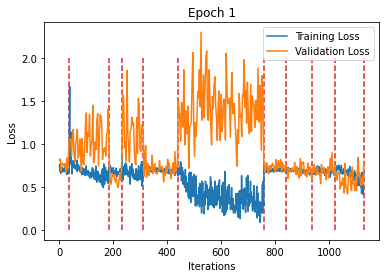

Train



Sequence:1, Seq Training Mean Loss: 0.6951450093372448, Seq Training Acc: 0.49324324324324326
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.5040507994642194, Seq Training Acc: 0.7606963087248322
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6083994176652696, Seq Training Acc: 0.6680555555555555
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6862771879007787, Seq Training Acc: 0.6022376543209876
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6934833902073657, Seq Training Acc: 0.5250984251968503
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.31102480444143404, Seq Training Acc: 0.8620283018867925
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6942375680295433, Seq Training Acc: 0.5160060975609756
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.6788169913685199, Seq Training Acc: 0.5547680412371134
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.638010985549839, Seq Training Acc: 0.6343390804597702
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.5550511287382016, Seq Training Acc: 0.7172475961538461
******************************************************************
Epoch:2, Epoch Training Loss Mean: 0.5383972525596619, Epoch Training Acc: 0.689579636202307
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7069836755593618, Seq Valid Acc: 0.5



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.8338637506961822, Seq Valid Acc: 0.604375



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5512108087539673, Seq Valid Acc: 0.76875



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.9061534206072489, Seq Valid Acc: 0.5405092592592593



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7539656673158918, Seq Valid Acc: 0.4851190476190476



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.2247738585157215, Seq Valid Acc: 0.5168042452830188



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6909782820277743, Seq Valid Acc: 0.5729166666666666



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6502022797411139, Seq Valid Acc: 0.6429924242424242



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.7265152417380234, Seq Valid Acc: 0.5872844827586207



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.5076797061106738, Seq Valid Acc: 0.7490808823529411
Epoch:2, Epoch Valid Mean Loss: 0.8609253764152527, Epoch Valid Acc: 0.5778333333333333
******************************************************************


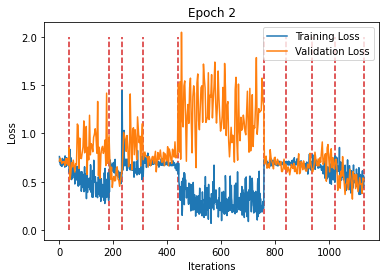

Train



Sequence:1, Seq Training Mean Loss: 0.6907283985936964, Seq Training Acc: 0.5388513513513513
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4579475071006173, Seq Training Acc: 0.7925755033557047
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.5032834662331476, Seq Training Acc: 0.7701388888888889
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.522335312616678, Seq Training Acc: 0.7384259259259259
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6861809956745839, Seq Training Acc: 0.5561023622047244
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3002585402496581, Seq Training Acc: 0.8752948113207547
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6829451736880512, Seq Training Acc: 0.5491615853658537
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.639048980990636, Seq Training Acc: 0.6295103092783505
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.6203444072569924, Seq Training Acc: 0.6681034482758621
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.5663767949892924, Seq Training Acc: 0.7157451923076923
******************************************************************
Epoch:3, Epoch Training Loss Mean: 0.5077529549598694, Epoch Training Acc: 0.7277062999112689
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7781291902065277, Seq Valid Acc: 0.4348958333333333



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6925917422771454, Seq Valid Acc: 0.6375



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5270544449488322, Seq Valid Acc: 0.75



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.7824841450761866, Seq Valid Acc: 0.5706018518518519



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7491829182420459, Seq Valid Acc: 0.5081845238095238



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.238672395922103, Seq Valid Acc: 0.5256485849056604



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7196670020068133, Seq Valid Acc: 0.5509259259259259



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6467261187957994, Seq Valid Acc: 0.6325757575757576



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6584410030266334, Seq Valid Acc: 0.6282327586206896



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.4827125510748695, Seq Valid Acc: 0.7619485294117647
Epoch:3, Epoch Valid Mean Loss: 0.8321199417114258, Epoch Valid Acc: 0.5885
******************************************************************


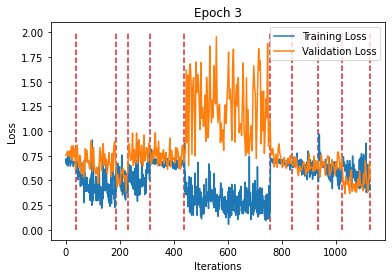

Train



Sequence:1, Seq Training Mean Loss: 0.6975902028985925, Seq Training Acc: 0.5253378378378378
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.40583015428293473, Seq Training Acc: 0.8187919463087249
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4497617022858726, Seq Training Acc: 0.8020833333333334
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6447247178466232, Seq Training Acc: 0.6215277777777778
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6869285482121265, Seq Training Acc: 0.5497047244094488
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.27063354596776784, Seq Training Acc: 0.8862028301886793
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6562610348550285, Seq Training Acc: 0.6154725609756098
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.6134254164302472, Seq Training Acc: 0.65625
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.5853476503799702, Seq Training Acc: 0.7065373563218391
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.5939173308702616, Seq Training Acc: 0.6844951923076923
******************************************************************
Epoch:4, Epoch Training Loss Mean: 0.49516528844833374, Epoch Training Acc: 0.733168811002662
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7511750708023707, Seq Valid Acc: 0.4557291666666667



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.2005584967136382, Seq Valid Acc: 0.62



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6053954442342122, Seq Valid Acc: 0.6895833333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.293301482995351, Seq Valid Acc: 0.5752314814814815



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7154811904543922, Seq Valid Acc: 0.5193452380952381



******************************************************************
Sequence:6, Seq Valid Mean Loss: 3.1399395612050904, Seq Valid Acc: 0.47346698113207547



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7037780329033181, Seq Valid Acc: 0.5185185185185185



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6379387721870885, Seq Valid Acc: 0.6628787878787878



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6222143748710895, Seq Valid Acc: 0.6745689655172413



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.5429205166942933, Seq Valid Acc: 0.7408088235294118
Epoch:4, Epoch Valid Mean Loss: 1.4732890129089355, Epoch Valid Acc: 0.57325
******************************************************************


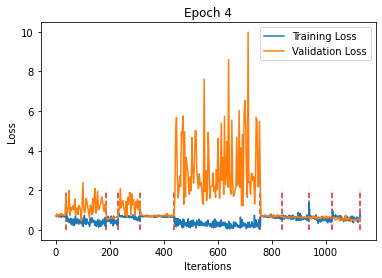

Train



Sequence:1, Seq Training Mean Loss: 0.6937738737544498, Seq Training Acc: 0.5236486486486487
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4044778363016628, Seq Training Acc: 0.8200503355704698
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.49475890530480277, Seq Training Acc: 0.7743055555555556
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5163296328650581, Seq Training Acc: 0.7496141975308642
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6807271129503025, Seq Training Acc: 0.5600393700787402
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.25056726720078654, Seq Training Acc: 0.8904284591194969
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6541049095188699, Seq Training Acc: 0.6234756097560976
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.595661919756034, Seq Training Acc: 0.6929768041237113
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.551919556897262, Seq Training Acc: 0.7302442528735632
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.5396613131922025, Seq Training Acc: 0.7394831730769231
******************************************************************
Epoch:5, Epoch Training Loss Mean: 0.471795916557312, Epoch Training Acc: 0.7543811002661934
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7090687950452169, Seq Valid Acc: 0.46875



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6917832285165787, Seq Valid Acc: 0.621875



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5722300211588541, Seq Valid Acc: 0.7375



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.7627091098714758, Seq Valid Acc: 0.5659722222222222



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7222521404425303, Seq Valid Acc: 0.5



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.0944279139896609, Seq Valid Acc: 0.5291863207547169



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6934607161415948, Seq Valid Acc: 0.5300925925925926



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6391743186748389, Seq Valid Acc: 0.6799242424242424



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.7031959028079592, Seq Valid Acc: 0.5862068965517241



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.5264368074781755, Seq Valid Acc: 0.7490808823529411
Epoch:5, Epoch Valid Mean Loss: 0.7912700176239014, Epoch Valid Acc: 0.585
******************************************************************


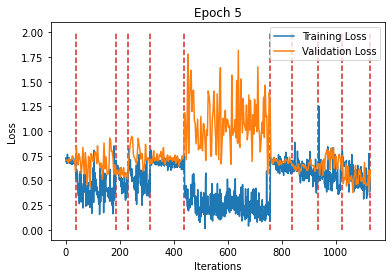

Train



Sequence:1, Seq Training Mean Loss: 0.6959481029897123, Seq Training Acc: 0.504222972972973
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4064406929600159, Seq Training Acc: 0.8259228187919463
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4692994253502952, Seq Training Acc: 0.7916666666666666
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4662613219317095, Seq Training Acc: 0.7800925925925926
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6916919871578067, Seq Training Acc: 0.5455216535433071
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.2755482742012297, Seq Training Acc: 0.88374606918239
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6671198751868271, Seq Training Acc: 0.5952743902439024
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.5717192940490762, Seq Training Acc: 0.7042525773195877
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.5305944249547762, Seq Training Acc: 0.7539511494252874
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.5437445359734389, Seq Training Acc: 0.7409855769230769
******************************************************************
Epoch:6, Epoch Training Loss Mean: 0.4734129309654236, Epoch Training Acc: 0.7547692990239574
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7295018384853998, Seq Valid Acc: 0.4713541666666667



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6557976567745208, Seq Valid Acc: 0.64125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5221179127693176, Seq Valid Acc: 0.7875



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6907067133320702, Seq Valid Acc: 0.5879629629629629



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7458744105838594, Seq Valid Acc: 0.5014880952380952



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.8243821437628764, Seq Valid Acc: 0.5117924528301887



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.711523554943226, Seq Valid Acc: 0.5162037037037037



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6524304747581482, Seq Valid Acc: 0.6458333333333334



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.7431344369362141, Seq Valid Acc: 0.5765086206896551



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.48828208183541016, Seq Valid Acc: 0.7821691176470589
Epoch:6, Epoch Valid Mean Loss: 0.7083461880683899, Epoch Valid Acc: 0.58475
******************************************************************


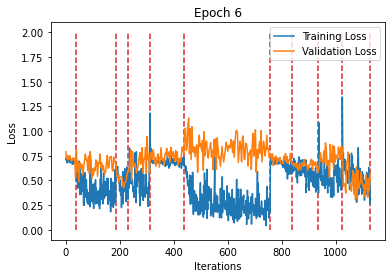

Train



Sequence:1, Seq Training Mean Loss: 0.6986719659856848, Seq Training Acc: 0.5152027027027027
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3745554926611433, Seq Training Acc: 0.8401845637583892
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4610447820689943, Seq Training Acc: 0.8027777777777778
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5128122244352176, Seq Training Acc: 0.7388117283950617
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6827100332327715, Seq Training Acc: 0.5597933070866141
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.2926329863052698, Seq Training Acc: 0.8811910377358491
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6588680119049258, Seq Training Acc: 0.6204268292682927
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.5502610891750178, Seq Training Acc: 0.7287371134020618
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.5052704341795252, Seq Training Acc: 0.7614942528735632
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.534220853390602, Seq Training Acc: 0.7310697115384616
******************************************************************
Epoch:7, Epoch Training Loss Mean: 0.47083044052124023, Epoch Training Acc: 0.7589840283939663
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.709299311041832, Seq Valid Acc: 0.453125



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7473224985599518, Seq Valid Acc: 0.653125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5849075794219971, Seq Valid Acc: 0.7583333333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.7646971543629965, Seq Valid Acc: 0.6053240740740741



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7041517013595218, Seq Valid Acc: 0.5163690476190477



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.2545779622950644, Seq Valid Acc: 0.4893867924528302



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6853839114860252, Seq Valid Acc: 0.5763888888888888



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6529401432384144, Seq Valid Acc: 0.6685606060606061



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6582867112653009, Seq Valid Acc: 0.6314655172413793



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.48834632337093353, Seq Valid Acc: 0.8042279411764706
Epoch:7, Epoch Valid Mean Loss: 0.8362780809402466, Epoch Valid Acc: 0.59375
******************************************************************


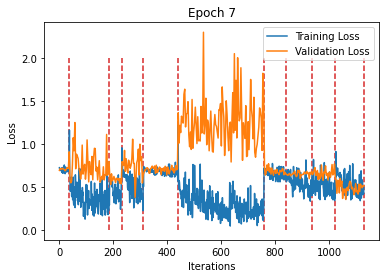

Train



Sequence:1, Seq Training Mean Loss: 0.7008309090459669, Seq Training Acc: 0.47635135135135137
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.38902006883349194, Seq Training Acc: 0.8361996644295302
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4321716547012329, Seq Training Acc: 0.8097222222222222
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.44191759879942294, Seq Training Acc: 0.8024691358024691
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6979462570092809, Seq Training Acc: 0.5280511811023622
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.27075682387177674, Seq Training Acc: 0.8920990566037735
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6626691040469379, Seq Training Acc: 0.6036585365853658
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.5580939211181759, Seq Training Acc: 0.7197164948453608
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.4900222862588948, Seq Training Acc: 0.7672413793103449
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.5083503728875747, Seq Training Acc: 0.7680288461538461
******************************************************************
Epoch:8, Epoch Training Loss Mean: 0.45949599146842957, Epoch Training Acc: 0.7633928571428571
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7014026691516241, Seq Valid Acc: 0.4453125



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.784665904045105, Seq Valid Acc: 0.615625



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6054972290992737, Seq Valid Acc: 0.7208333333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.7805088096194797, Seq Valid Acc: 0.5856481481481481



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7134841254779271, Seq Valid Acc: 0.5074404761904762



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.1791264600348923, Seq Valid Acc: 0.47759433962264153



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6941140934273049, Seq Valid Acc: 0.5462962962962963



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6579452355702718, Seq Valid Acc: 0.6496212121212122



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.7107333253169882, Seq Valid Acc: 0.5711206896551724



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.49091290200457854, Seq Valid Acc: 0.7858455882352942
Epoch:8, Epoch Valid Mean Loss: 0.828041672706604, Epoch Valid Acc: 0.5710833333333334
******************************************************************


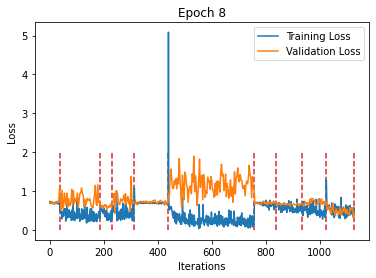

Train



Sequence:1, Seq Training Mean Loss: 0.6983962574520627, Seq Training Acc: 0.46368243243243246
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.39811123697549705, Seq Training Acc: 0.8288590604026845
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4289792680078083, Seq Training Acc: 0.8194444444444444
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.44558427547231133, Seq Training Acc: 0.7970679012345679
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.690578001221334, Seq Training Acc: 0.531742125984252
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.23323067666599587, Seq Training Acc: 0.9029088050314465
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6643202668283044, Seq Training Acc: 0.5983231707317073
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.5446607501236433, Seq Training Acc: 0.7374355670103093
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.4826848955675103, Seq Training Acc: 0.7722701149425287
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.5187392742014848, Seq Training Acc: 0.7587139423076923
******************************************************************
Epoch:9, Epoch Training Loss Mean: 0.4486914277076721, Epoch Training Acc: 0.7661379769299024
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.724278062582016, Seq Valid Acc: 0.4453125



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7048372513055802, Seq Valid Acc: 0.63



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5881101409594218, Seq Valid Acc: 0.725



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.7868690468646862, Seq Valid Acc: 0.5381944444444444



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7184470735845112, Seq Valid Acc: 0.5096726190476191



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.0306920949018226, Seq Valid Acc: 0.4846698113207547



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7040664045899002, Seq Valid Acc: 0.5370370370370371



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6596921610109734, Seq Valid Acc: 0.6117424242424242



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.7133106363230738, Seq Valid Acc: 0.5657327586206896



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.4476908866096945, Seq Valid Acc: 0.796875
Epoch:9, Epoch Valid Mean Loss: 0.7736415863037109, Epoch Valid Acc: 0.5685833333333333
******************************************************************


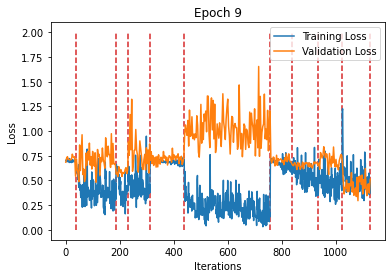

Train



Sequence:1, Seq Training Mean Loss: 0.696272840371003, Seq Training Acc: 0.5008445945945946
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.35693691080848644, Seq Training Acc: 0.8464765100671141
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.44823463029331634, Seq Training Acc: 0.80625
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.42524755626548955, Seq Training Acc: 0.814429012345679
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6942652891001363, Seq Training Acc: 0.5191929133858267
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.22215237079551384, Seq Training Acc: 0.9082154088050315
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.643328582368246, Seq Training Acc: 0.6291920731707317
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.5154194601417816, Seq Training Acc: 0.7496778350515464
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.45299994226159723, Seq Training Acc: 0.7941810344827587
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.45140751350957614, Seq Training Acc: 0.7905649038461539
******************************************************************
Epoch:10, Epoch Training Loss Mean: 0.427225798368454, Epoch Training Acc: 0.7784216947648624
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7129780302445093, Seq Valid Acc: 0.4869791666666667



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7707947081327439, Seq Valid Acc: 0.65



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5626128355662028, Seq Valid Acc: 0.75



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.8152226916065922, Seq Valid Acc: 0.59375



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.742859157777968, Seq Valid Acc: 0.5044642857142857



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.5265366221373935, Seq Valid Acc: 0.46226415094339623



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7144751129326997, Seq Valid Acc: 0.5462962962962963



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6555897990862528, Seq Valid Acc: 0.6543560606060606



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.7862241535351194, Seq Valid Acc: 0.5463362068965517



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.3743661756024641, Seq Valid Acc: 0.8483455882352942
Epoch:10, Epoch Valid Mean Loss: 0.9253676533699036, Epoch Valid Acc: 0.57825
******************************************************************


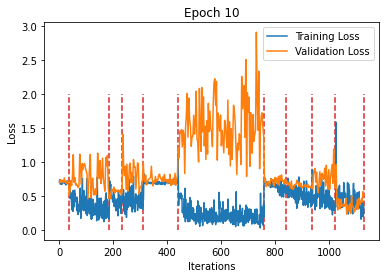

Train



Sequence:1, Seq Training Mean Loss: 0.6942823915868193, Seq Training Acc: 0.5076013513513513
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3495545544780341, Seq Training Acc: 0.8536073825503355
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4549350798130035, Seq Training Acc: 0.7868055555555555
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.40336504615383384, Seq Training Acc: 0.8244598765432098
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6995505117994594, Seq Training Acc: 0.5337106299212598
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.20422455759824448, Seq Training Acc: 0.9152908805031447
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6866406006057088, Seq Training Acc: 0.5544969512195121
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.5694126855466783, Seq Training Acc: 0.7152061855670103
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.4566616056294277, Seq Training Acc: 0.7877155172413793
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.4074381866420691, Seq Training Acc: 0.8152043269230769
******************************************************************
Epoch:11, Epoch Training Loss Mean: 0.4244398772716522, Epoch Training Acc: 0.7765361579414375
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7316223531961441, Seq Valid Acc: 0.4713541666666667



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.8959897255897522, Seq Valid Acc: 0.65875



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.621701447168986, Seq Valid Acc: 0.7125



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.9511468874083625, Seq Valid Acc: 0.6111111111111112



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7347576149872371, Seq Valid Acc: 0.47767857142857145



******************************************************************
Sequence:6, Seq Valid Mean Loss: 2.258935848496995, Seq Valid Acc: 0.4837853773584906



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7035868521089907, Seq Valid Acc: 0.5335648148148148



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6689366373148832, Seq Valid Acc: 0.5795454545454546



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.7237552075550474, Seq Valid Acc: 0.5441810344827587



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.4042732207214131, Seq Valid Acc: 0.8428308823529411
Epoch:11, Epoch Valid Mean Loss: 1.1591957807540894, Epoch Valid Acc: 0.5735833333333333
******************************************************************


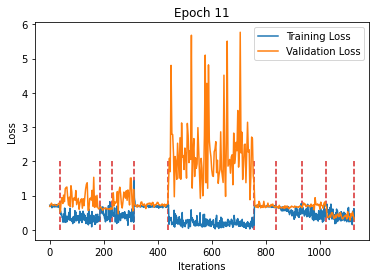

Train



Sequence:1, Seq Training Mean Loss: 0.6930739557420885, Seq Training Acc: 0.512668918918919
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3409215454887224, Seq Training Acc: 0.8531879194630873
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.5106978605190913, Seq Training Acc: 0.7534722222222222
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.38185468113716736, Seq Training Acc: 0.8248456790123457
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6861291640386806, Seq Training Acc: 0.547736220472441
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.19893037535414193, Seq Training Acc: 0.9161753144654088
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6590317393221506, Seq Training Acc: 0.6166158536585366
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.5153837907560093, Seq Training Acc: 0.7567654639175257
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.47141524652640027, Seq Training Acc: 0.7744252873563219
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.44616089374400103, Seq Training Acc: 0.8019831730769231
******************************************************************
Epoch:12, Epoch Training Loss Mean: 0.41898635029792786, Epoch Training Acc: 0.7830246228926353
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7027914126714071, Seq Valid Acc: 0.5052083333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7652295780181885, Seq Valid Acc: 0.655



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6514784336090088, Seq Valid Acc: 0.68125



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.7576571725032948, Seq Valid Acc: 0.6215277777777778



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.711162730341866, Seq Valid Acc: 0.5007440476190477



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.5535255906716832, Seq Valid Acc: 0.5141509433962265



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7110819154315524, Seq Valid Acc: 0.5104166666666666



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6804115501317111, Seq Valid Acc: 0.553030303030303



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.7001393211298975, Seq Valid Acc: 0.5237068965517241



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.4618847554220873, Seq Valid Acc: 0.8033088235294118
Epoch:12, Epoch Valid Mean Loss: 0.9310062527656555, Epoch Valid Acc: 0.5756666666666667
******************************************************************


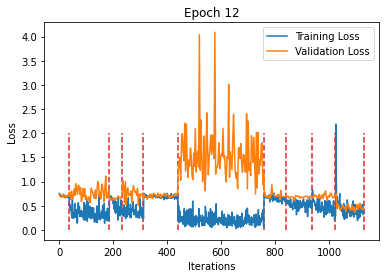

Train



Sequence:1, Seq Training Mean Loss: 0.7010802401078714, Seq Training Acc: 0.5101351351351351
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.343596501788437, Seq Training Acc: 0.8569630872483222
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.48782074054082236, Seq Training Acc: 0.7722222222222223
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4017530142525096, Seq Training Acc: 0.8206018518518519
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6767733510084978, Seq Training Acc: 0.5686515748031497
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.238844018183508, Seq Training Acc: 0.9135220125786163
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6610486761825841, Seq Training Acc: 0.6021341463414634
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.5267057176103297, Seq Training Acc: 0.75
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.4649893055702078, Seq Training Acc: 0.7852011494252874
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.4113914066782364, Seq Training Acc: 0.8173076923076923
******************************************************************
Epoch:13, Epoch Training Loss Mean: 0.4277441203594208, Epoch Training Acc: 0.7861024844720497
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6991026749213537, Seq Valid Acc: 0.53125



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7151154732704162, Seq Valid Acc: 0.65625



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6452526926994324, Seq Valid Acc: 0.6979166666666666



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.7057768018157394, Seq Valid Acc: 0.6643518518518519



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7094329992930094, Seq Valid Acc: 0.5119047619047619



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.5010402163244643, Seq Valid Acc: 0.5029481132075472



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.710952553484175, Seq Valid Acc: 0.5578703703703703



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6791746327371309, Seq Valid Acc: 0.5729166666666666



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.7043482784567208, Seq Valid Acc: 0.5420258620689655



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.42506549814168143, Seq Valid Acc: 0.8235294117647058
Epoch:13, Epoch Valid Mean Loss: 0.9020613431930542, Epoch Valid Acc: 0.5869166666666666
******************************************************************


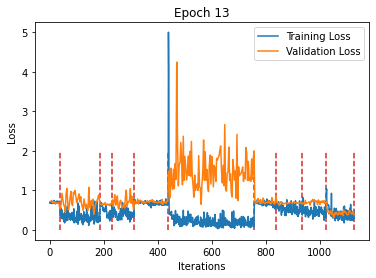

Train



Sequence:1, Seq Training Mean Loss: 0.6930546712230992, Seq Training Acc: 0.5236486486486487
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3330091674055829, Seq Training Acc: 0.8613674496644296
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4697699328263601, Seq Training Acc: 0.7798611111111111
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.37985871069961125, Seq Training Acc: 0.8344907407407407
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.7018172609524465, Seq Training Acc: 0.5290354330708661
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.20128153908833768, Seq Training Acc: 0.9214819182389937
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6588940998403038, Seq Training Acc: 0.6360518292682927
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.5177278116191786, Seq Training Acc: 0.7467783505154639
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.47015228781891966, Seq Training Acc: 0.7848419540229885
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.4027409991965844, Seq Training Acc: 0.8218149038461539
******************************************************************
Epoch:14, Epoch Training Loss Mean: 0.41468068957328796, Epoch Training Acc: 0.7887921472937001
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7081303596496582, Seq Valid Acc: 0.4765625



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7278436756134034, Seq Valid Acc: 0.645625



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6329345146814982, Seq Valid Acc: 0.7083333333333334



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.8617661352510806, Seq Valid Acc: 0.5648148148148148



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7122760301544553, Seq Valid Acc: 0.5186011904761905



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.4382778608574058, Seq Valid Acc: 0.5433372641509434



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6953011596644366, Seq Valid Acc: 0.5671296296296297



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6759776111805078, Seq Valid Acc: 0.5814393939393939



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6729347212561245, Seq Valid Acc: 0.615301724137931



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.40898530448184295, Seq Valid Acc: 0.8336397058823529
Epoch:14, Epoch Valid Mean Loss: 0.8920680284500122, Epoch Valid Acc: 0.5971666666666666
******************************************************************


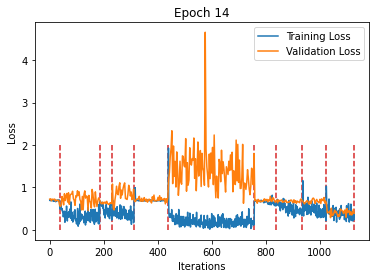

Train



Sequence:1, Seq Training Mean Loss: 0.6923907946895909, Seq Training Acc: 0.5025337837837838
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3172844231828747, Seq Training Acc: 0.863255033557047
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.43453415168656245, Seq Training Acc: 0.8034722222222223
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3859559952476878, Seq Training Acc: 0.8248456790123457
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6917675935377287, Seq Training Acc: 0.5369094488188977
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.18055319380155713, Seq Training Acc: 0.9276729559748428
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6474381416309171, Seq Training Acc: 0.6234756097560976
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.4966657813062373, Seq Training Acc: 0.7628865979381443
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.45454587778825867, Seq Training Acc: 0.7952586206896551
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.3750191001364818, Seq Training Acc: 0.8200120192307693
******************************************************************
Epoch:15, Epoch Training Loss Mean: 0.39822065830230713, Epoch Training Acc: 0.7923413930789707
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7153459986050924, Seq Valid Acc: 0.4739583333333333



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7839167511463165, Seq Valid Acc: 0.63125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5500422457853953, Seq Valid Acc: 0.75



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.8508150555469371, Seq Valid Acc: 0.5983796296296297



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.773275301569984, Seq Valid Acc: 0.5029761904761905



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.679869200823442, Seq Valid Acc: 0.5253537735849056



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7453420206352517, Seq Valid Acc: 0.5486111111111112



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6627322128324797, Seq Valid Acc: 0.5918560606060606



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.7185287824992476, Seq Valid Acc: 0.6088362068965517



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.35744907575495105, Seq Valid Acc: 0.8391544117647058
Epoch:15, Epoch Valid Mean Loss: 0.9720835089683533, Epoch Valid Acc: 0.592
******************************************************************


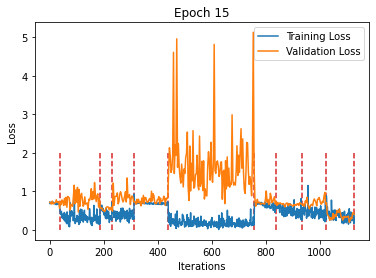

Train



Sequence:1, Seq Training Mean Loss: 0.6918615344408396, Seq Training Acc: 0.53125
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.32771825785404884, Seq Training Acc: 0.8594798657718121
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4174300584528181, Seq Training Acc: 0.8131944444444444
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3766225774163081, Seq Training Acc: 0.8263888888888888
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.7008379059513723, Seq Training Acc: 0.5189468503937008
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.1710412715965847, Seq Training Acc: 0.9284591194968553
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6651381704865432, Seq Training Acc: 0.609375
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.5006728648524923, Seq Training Acc: 0.7548324742268041
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.4664355156750515, Seq Training Acc: 0.7923850574712644
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.39555107400967526, Seq Training Acc: 0.8152043269230769
******************************************************************
Epoch:16, Epoch Training Loss Mean: 0.4010124206542969, Epoch Training Acc: 0.7890971606033718
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7069394091765085, Seq Valid Acc: 0.453125



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.8405045235157013, Seq Valid Acc: 0.658125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.606488049030304, Seq Valid Acc: 0.7



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.9307526063036036, Seq Valid Acc: 0.6238425925925926



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7426431562219348, Seq Valid Acc: 0.48214285714285715



******************************************************************
Sequence:6, Seq Valid Mean Loss: 2.1867543194653853, Seq Valid Acc: 0.5663325471698113



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7159218655692207, Seq Valid Acc: 0.5694444444444444



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6643314018394008, Seq Valid Acc: 0.6174242424242424



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6754398202073986, Seq Valid Acc: 0.6325431034482759



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.35019587856881756, Seq Valid Acc: 0.8676470588235294
Epoch:16, Epoch Valid Mean Loss: 1.1212542057037354, Epoch Valid Acc: 0.6121666666666666
******************************************************************


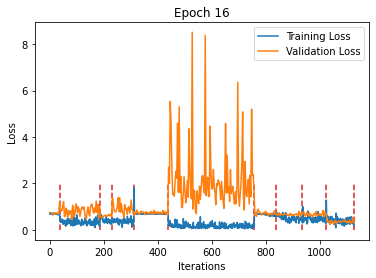

Train



Sequence:1, Seq Training Mean Loss: 0.6909864335446745, Seq Training Acc: 0.5236486486486487
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2803447006032771, Seq Training Acc: 0.8886325503355704
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4437519987424215, Seq Training Acc: 0.7930555555555555
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.37847737397676634, Seq Training Acc: 0.8275462962962963
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6883666534123458, Seq Training Acc: 0.5403543307086615
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.16804619308315077, Seq Training Acc: 0.9281643081761006
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6246467945052356, Seq Training Acc: 0.6413871951219512
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.5005554836435416, Seq Training Acc: 0.7625644329896907
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.4296874667721233, Seq Training Acc: 0.8010057471264368
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.3638657287049752, Seq Training Acc: 0.8353365384615384
******************************************************************
Epoch:17, Epoch Training Loss Mean: 0.3849373161792755, Epoch Training Acc: 0.799828083407276
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6849298675855001, Seq Valid Acc: 0.546875



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.065230529308319, Seq Valid Acc: 0.6125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6196069717407227, Seq Valid Acc: 0.7270833333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.0641364985042148, Seq Valid Acc: 0.5787037037037037



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7194257577260336, Seq Valid Acc: 0.49776785714285715



******************************************************************
Sequence:6, Seq Valid Mean Loss: 2.1805503784485585, Seq Valid Acc: 0.5412735849056604



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7009192020804794, Seq Valid Acc: 0.5821759259259259



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6684584382808569, Seq Valid Acc: 0.6325757575757576



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6425962489226769, Seq Valid Acc: 0.6594827586206896



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.43697380756630616, Seq Valid Acc: 0.8244485294117647
Epoch:17, Epoch Valid Mean Loss: 1.1608988046646118, Epoch Valid Acc: 0.602
******************************************************************


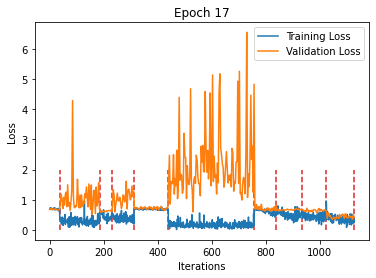

Train



Sequence:1, Seq Training Mean Loss: 0.648171426476659, Seq Training Acc: 0.6486486486486487
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3074306062603957, Seq Training Acc: 0.8745805369127517
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4256722072760264, Seq Training Acc: 0.7958333333333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3723918363267993, Seq Training Acc: 0.8387345679012346
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6900519282799068, Seq Training Acc: 0.5499507874015748
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.1625668192106598, Seq Training Acc: 0.9311124213836478
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6387431149075671, Seq Training Acc: 0.6570121951219512
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.4751087580759501, Seq Training Acc: 0.7854381443298969
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.42871902420603, Seq Training Acc: 0.8135775862068966
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.3745557518246082, Seq Training Acc: 0.8374399038461539
******************************************************************
Epoch:18, Epoch Training Loss Mean: 0.3843444585800171, Epoch Training Acc: 0.8091725820763088
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6910626838604609, Seq Valid Acc: 0.5390625



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.737709311246872, Seq Valid Acc: 0.66375



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.563915898402532, Seq Valid Acc: 0.7645833333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.8629840303350378, Seq Valid Acc: 0.6412037037037037



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7224552106289637, Seq Valid Acc: 0.49702380952380953



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.817652698957695, Seq Valid Acc: 0.5268278301886793



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7108644335358231, Seq Valid Acc: 0.53125



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.661899107875246, Seq Valid Acc: 0.5833333333333334



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.686296664435288, Seq Valid Acc: 0.6023706896551724



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.3519316574229914, Seq Valid Acc: 0.8658088235294118
Epoch:18, Epoch Valid Mean Loss: 0.9942830204963684, Epoch Valid Acc: 0.60175
******************************************************************


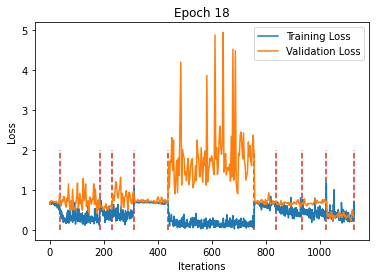

Train



Sequence:1, Seq Training Mean Loss: 0.6624243726601472, Seq Training Acc: 0.643581081081081
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2998593349584797, Seq Training Acc: 0.8764681208053692
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4391226566500134, Seq Training Acc: 0.8027777777777778
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.36055156827708823, Seq Training Acc: 0.8321759259259259
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6937951314167714, Seq Training Acc: 0.547736220472441
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.16322637327694856, Seq Training Acc: 0.9337657232704403
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.610715298754413, Seq Training Acc: 0.666920731707317
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.4599896374436998, Seq Training Acc: 0.7909149484536082
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.46736091786417466, Seq Training Acc: 0.7834051724137931
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.3422165846881958, Seq Training Acc: 0.8413461538461539
******************************************************************
Epoch:19, Epoch Training Loss Mean: 0.38076353073120117, Epoch Training Acc: 0.8087843833185449
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6373357772827148, Seq Valid Acc: 0.6588541666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.9169101560115814, Seq Valid Acc: 0.63625



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6003235499064128, Seq Valid Acc: 0.7354166666666667



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.147889064417945, Seq Valid Acc: 0.6273148148148148



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7381839766388848, Seq Valid Acc: 0.4880952380952381



******************************************************************
Sequence:6, Seq Valid Mean Loss: 2.5922246749671, Seq Valid Acc: 0.5291863207547169



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7182152492028696, Seq Valid Acc: 0.5567129629629629



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6650045929533063, Seq Valid Acc: 0.6325757575757576



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6555020377553743, Seq Valid Acc: 0.6379310344827587



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.3925788735642153, Seq Valid Acc: 0.8446691176470589
Epoch:19, Epoch Valid Mean Loss: 1.2612403631210327, Epoch Valid Acc: 0.6064166666666667
******************************************************************


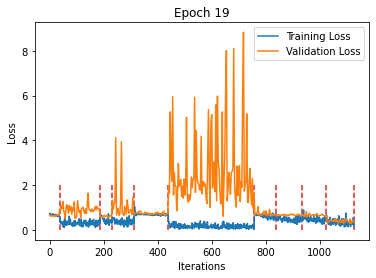

Train



Sequence:1, Seq Training Mean Loss: 0.5320286025872102, Seq Training Acc: 0.75
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2820472317754022, Seq Training Acc: 0.8844379194630873
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.40880237387286295, Seq Training Acc: 0.8159722222222222
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.35809658265408173, Seq Training Acc: 0.84375
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6975534342405364, Seq Training Acc: 0.5501968503937008
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.1679000966133749, Seq Training Acc: 0.92875393081761
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6137780499894444, Seq Training Acc: 0.6733993902439024
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.4897625907180236, Seq Training Acc: 0.7699742268041238
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.4171283543109894, Seq Training Acc: 0.8078304597701149
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.3441961904844412, Seq Training Acc: 0.8428485576923077
******************************************************************
Epoch:20, Epoch Training Loss Mean: 0.3735731244087219, Epoch Training Acc: 0.8142468944099379
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5743359476327896, Seq Valid Acc: 0.7708333333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.973377720117569, Seq Valid Acc: 0.6275



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5944264928499857, Seq Valid Acc: 0.7458333333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.9703400245419255, Seq Valid Acc: 0.6458333333333334



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7173651996113005, Seq Valid Acc: 0.5



******************************************************************
Sequence:6, Seq Valid Mean Loss: 3.0786986345390104, Seq Valid Acc: 0.5480542452830188



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6913221544689603, Seq Valid Acc: 0.59375



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6537480823921434, Seq Valid Acc: 0.6202651515151515



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6585921316311277, Seq Valid Acc: 0.6379310344827587



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.3786899500033435, Seq Valid Acc: 0.8777573529411765
Epoch:20, Epoch Valid Mean Loss: 1.384965181350708, Epoch Valid Acc: 0.6218333333333333
******************************************************************


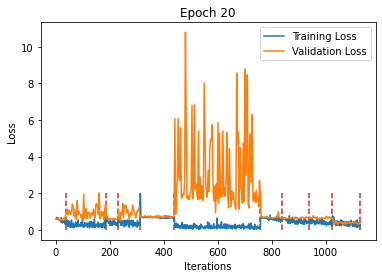

Train



Sequence:1, Seq Training Mean Loss: 0.4985029749773644, Seq Training Acc: 0.7592905405405406
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2885210616076553, Seq Training Acc: 0.8758389261744967
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3738527854283651, Seq Training Acc: 0.8388888888888889
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.34398900745091615, Seq Training Acc: 0.8472222222222222
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6688626535295501, Seq Training Acc: 0.59375
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.16402844414583542, Seq Training Acc: 0.9309158805031447
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6270633666980557, Seq Training Acc: 0.6581554878048781
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.4684705995407301, Seq Training Acc: 0.7773840206185567
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.4216494794892169, Seq Training Acc: 0.8110632183908046
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.3280203422674766, Seq Training Acc: 0.8497596153846154
******************************************************************
Epoch:21, Epoch Training Loss Mean: 0.36458367109298706, Epoch Training Acc: 0.8205135314995563
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5795532763004303, Seq Valid Acc: 0.7526041666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.0121393239498138, Seq Valid Acc: 0.629375



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.59856276512146, Seq Valid Acc: 0.7395833333333334



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.1987253692415025, Seq Valid Acc: 0.5810185185185185



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7225353178523836, Seq Valid Acc: 0.4895833333333333



******************************************************************
Sequence:6, Seq Valid Mean Loss: 3.945066747800359, Seq Valid Acc: 0.5103183962264151



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7151260795416655, Seq Valid Acc: 0.5671296296296297



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6399458104913885, Seq Valid Acc: 0.665719696969697



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6495568423435606, Seq Valid Acc: 0.6734913793103449



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.44009826551465425, Seq Valid Acc: 0.8226102941176471
Epoch:21, Epoch Valid Mean Loss: 1.657750129699707, Epoch Valid Acc: 0.6045833333333334
******************************************************************


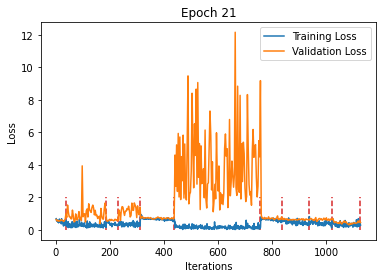

Train



Sequence:1, Seq Training Mean Loss: 0.4490453222313443, Seq Training Acc: 0.7930743243243243
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.26801729687308307, Seq Training Acc: 0.8871644295302014
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.36575667725669014, Seq Training Acc: 0.8284722222222223
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.33693575491139915, Seq Training Acc: 0.8522376543209876
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6390892910206412, Seq Training Acc: 0.6318897637795275
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.1550926497006941, Seq Training Acc: 0.9343553459119497
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.5830681124111501, Seq Training Acc: 0.7050304878048781
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.4474174911828385, Seq Training Acc: 0.7883376288659794
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.434846545772991, Seq Training Acc: 0.8045977011494253
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.3416639935368529, Seq Training Acc: 0.8449519230769231
******************************************************************
Epoch:22, Epoch Training Loss Mean: 0.35080716013908386, Epoch Training Acc: 0.8317435669920142
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6047146916389465, Seq Valid Acc: 0.7447916666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.8181832826137543, Seq Valid Acc: 0.653125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5175709187984466, Seq Valid Acc: 0.7833333333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.8141982113873517, Seq Valid Acc: 0.6122685185185185



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7863389863854363, Seq Valid Acc: 0.4479166666666667



******************************************************************
Sequence:6, Seq Valid Mean Loss: 2.1607260563463533, Seq Valid Acc: 0.5589622641509434



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7679962515830994, Seq Valid Acc: 0.5671296296296297



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6433217850598422, Seq Valid Acc: 0.6410984848484849



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6941080689430237, Seq Valid Acc: 0.6368534482758621



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.28213123582741795, Seq Valid Acc: 0.890625
Epoch:22, Epoch Valid Mean Loss: 1.097767949104309, Epoch Valid Acc: 0.62175
******************************************************************


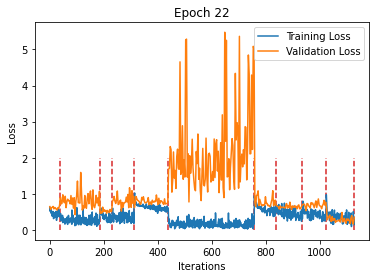

Train



Sequence:1, Seq Training Mean Loss: 0.41304494319735346, Seq Training Acc: 0.8074324324324325
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.28219164852927997, Seq Training Acc: 0.8896812080536913
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3626474549372991, Seq Training Acc: 0.8333333333333334
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.335280998069563, Seq Training Acc: 0.8522376543209876
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5989994019504608, Seq Training Acc: 0.6687992125984252
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.1564690649169702, Seq Training Acc: 0.9334709119496856
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.5443129270541959, Seq Training Acc: 0.7111280487804879
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.4321982932766688, Seq Training Acc: 0.8044458762886598
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.42312978482109376, Seq Training Acc: 0.805316091954023
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.32034794986248016, Seq Training Acc: 0.8620793269230769
******************************************************************
Epoch:23, Epoch Training Loss Mean: 0.3401256501674652, Epoch Training Acc: 0.8401175687666371
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5320580278833708, Seq Valid Acc: 0.7890625



******************************************************************
Sequence:2, Seq Valid Mean Loss: 2.263853449821472, Seq Valid Acc: 0.639375



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5120749096075694, Seq Valid Acc: 0.7979166666666667



******************************************************************
Sequence:4, Seq Valid Mean Loss: 2.3512201574113636, Seq Valid Acc: 0.6331018518518519



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7233270860853649, Seq Valid Acc: 0.5141369047619048



******************************************************************
Sequence:6, Seq Valid Mean Loss: 9.280632847884917, Seq Valid Acc: 0.5283018867924528



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6912841002146403, Seq Valid Acc: 0.6180555555555556



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.652870465408672, Seq Valid Acc: 0.6107954545454546



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6479257797372753, Seq Valid Acc: 0.677801724137931



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.32623274887309356, Seq Valid Acc: 0.8897058823529411
Epoch:23, Epoch Valid Mean Loss: 3.3998918533325195, Epoch Valid Acc: 0.62625
******************************************************************


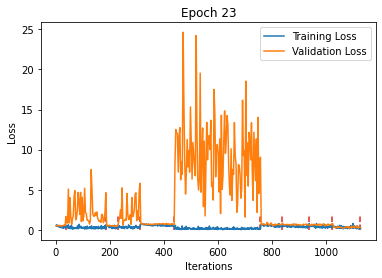

Train



Sequence:1, Seq Training Mean Loss: 0.36794483017277074, Seq Training Acc: 0.839527027027027
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2699004953739627, Seq Training Acc: 0.8884228187919463
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3390814469920264, Seq Training Acc: 0.8493055555555555
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.34774725672639445, Seq Training Acc: 0.8387345679012346
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5445320714177109, Seq Training Acc: 0.7202263779527559
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.14925570559172463, Seq Training Acc: 0.9396619496855346
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.5166462416329035, Seq Training Acc: 0.7442835365853658
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.42175842345375375, Seq Training Acc: 0.8060567010309279
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.4287533289057085, Seq Training Acc: 0.7999281609195402
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.3188098588815102, Seq Training Acc: 0.8533653846153846
******************************************************************
Epoch:24, Epoch Training Loss Mean: 0.32618239521980286, Epoch Training Acc: 0.8495452528837621
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5805664385358492, Seq Valid Acc: 0.7838541666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.824222412109375, Seq Valid Acc: 0.6575



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.539925996462504, Seq Valid Acc: 0.8020833333333334



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.8626984446137039, Seq Valid Acc: 0.6365740740740741



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7062130456879026, Seq Valid Acc: 0.5215773809523809



******************************************************************
Sequence:6, Seq Valid Mean Loss: 3.152072121512215, Seq Valid Acc: 0.5872641509433962



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7047596993269744, Seq Valid Acc: 0.6145833333333334



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.662275923020912, Seq Valid Acc: 0.5984848484848485



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6369596062035396, Seq Valid Acc: 0.6691810344827587



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.3457764720215517, Seq Valid Acc: 0.8639705882352942
Epoch:24, Epoch Valid Mean Loss: 1.371898889541626, Epoch Valid Acc: 0.6420833333333333
******************************************************************


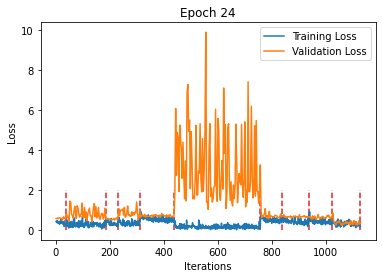

Train



Sequence:1, Seq Training Mean Loss: 0.3868439817750776, Seq Training Acc: 0.8226351351351351
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2722626797504873, Seq Training Acc: 0.8852768456375839
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.36384738948610096, Seq Training Acc: 0.8333333333333334
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.37149733636114335, Seq Training Acc: 0.8344907407407407
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5288166609101408, Seq Training Acc: 0.735236220472441
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.15437178411550304, Seq Training Acc: 0.9373034591194969
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.5097158373129077, Seq Training Acc: 0.743140243902439
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.42686417637412083, Seq Training Acc: 0.8047680412371134
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.4228382585034973, Seq Training Acc: 0.8107040229885057
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.3127825176343322, Seq Training Acc: 0.8575721153846154
******************************************************************
Epoch:25, Epoch Training Loss Mean: 0.3284060060977936, Epoch Training Acc: 0.8496838952972493
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6007367620865504, Seq Valid Acc: 0.734375



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.781114684343338, Seq Valid Acc: 0.62875



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5545284986495972, Seq Valid Acc: 0.8020833333333334



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.8241172013459382, Seq Valid Acc: 0.6064814814814815



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7342162614776975, Seq Valid Acc: 0.5089285714285714



******************************************************************
Sequence:6, Seq Valid Mean Loss: 1.762303594710692, Seq Valid Acc: 0.5893278301886793



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7539137138260735, Seq Valid Acc: 0.5555555555555556



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6138442267071117, Seq Valid Acc: 0.709280303030303



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6256360843263823, Seq Valid Acc: 0.6950431034482759



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.38293058819630565, Seq Valid Acc: 0.8722426470588235
Epoch:25, Epoch Valid Mean Loss: 0.976668119430542, Epoch Valid Acc: 0.6419166666666667
******************************************************************


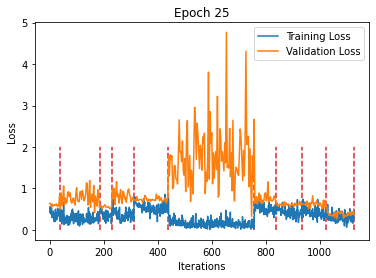

Train



Sequence:1, Seq Training Mean Loss: 0.34517397348945206, Seq Training Acc: 0.862331081081081
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2706687143885049, Seq Training Acc: 0.8856963087248322
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3356049848927392, Seq Training Acc: 0.8520833333333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.32360288868715736, Seq Training Acc: 0.8587962962962963
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5013162064270711, Seq Training Acc: 0.7465551181102362
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.15342767690103384, Seq Training Acc: 0.9316037735849056
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.5063606775025042, Seq Training Acc: 0.7435213414634146
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.42136182582255494, Seq Training Acc: 0.8186211340206185
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.40391139668979864, Seq Training Acc: 0.8135775862068966
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.29649207031784147, Seq Training Acc: 0.8581730769230769
******************************************************************
Epoch:26, Epoch Training Loss Mean: 0.3152098059654236, Epoch Training Acc: 0.8547027506654836
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6126211782296499, Seq Valid Acc: 0.7213541666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.3374399268627166, Seq Valid Acc: 0.65



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.553504741191864, Seq Valid Acc: 0.7395833333333334



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.4929562564249392, Seq Valid Acc: 0.6215277777777778



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.709706221308027, Seq Valid Acc: 0.546875



******************************************************************
Sequence:6, Seq Valid Mean Loss: 6.239657813648008, Seq Valid Acc: 0.5330188679245284



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.8048556800241824, Seq Valid Acc: 0.6134259259259259



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.629834791024526, Seq Valid Acc: 0.6306818181818182



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6214493718640558, Seq Valid Acc: 0.6950431034482759



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.3193653050590964, Seq Valid Acc: 0.8759191176470589
Epoch:26, Epoch Valid Mean Loss: 2.36118221282959, Epoch Valid Acc: 0.6288333333333334
******************************************************************


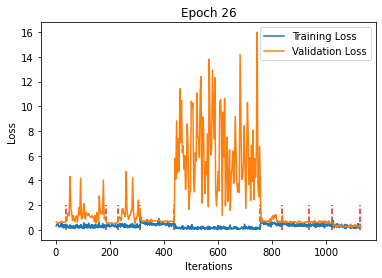

Train



Sequence:1, Seq Training Mean Loss: 0.3585720666356989, Seq Training Acc: 0.8386824324324325
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2600326959118747, Seq Training Acc: 0.8936661073825504
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3177694900168313, Seq Training Acc: 0.8631944444444445
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3325707550034111, Seq Training Acc: 0.8557098765432098
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.48557829610475406, Seq Training Acc: 0.7672244094488189
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.1486515323953621, Seq Training Acc: 0.9384827044025157
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.47946302483721476, Seq Training Acc: 0.7621951219512195
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.40194459812542827, Seq Training Acc: 0.8137886597938144
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.40791898006680366, Seq Training Acc: 0.8171695402298851
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.2884176095517782, Seq Training Acc: 0.8716947115384616
******************************************************************
Epoch:27, Epoch Training Loss Mean: 0.30699068307876587, Epoch Training Acc: 0.861939884649512
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.478026216228803, Seq Valid Acc: 0.796875



******************************************************************
Sequence:2, Seq Valid Mean Loss: 2.390021616220474, Seq Valid Acc: 0.614375



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5188286443551381, Seq Valid Acc: 0.7583333333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.8338836188669558, Seq Valid Acc: 0.59375



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.7518812772773561, Seq Valid Acc: 0.5



******************************************************************
Sequence:6, Seq Valid Mean Loss: 10.286044365954849, Seq Valid Acc: 0.5389150943396226



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6792075700230069, Seq Valid Acc: 0.6273148148148148



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.635829999591365, Seq Valid Acc: 0.665719696969697



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.6298980384037413, Seq Valid Acc: 0.6885775862068966



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.3172695053850903, Seq Valid Acc: 0.875
Epoch:27, Epoch Valid Mean Loss: 3.660825729370117, Epoch Valid Acc: 0.6251666666666666
******************************************************************


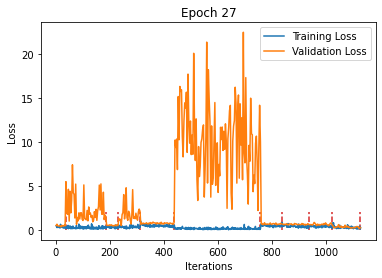

Train



Sequence:1, Seq Training Mean Loss: 0.32688093870072754, Seq Training Acc: 0.8589527027027027
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2622107518399322, Seq Training Acc: 0.8869546979865772
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3471540732516183, Seq Training Acc: 0.8451388888888889
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.31635071557981, Seq Training Acc: 0.8557098765432098
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.48204607944788896, Seq Training Acc: 0.7593503937007874
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.1464472692576969, Seq Training Acc: 0.9380896226415094
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.45634232715862555, Seq Training Acc: 0.7736280487804879
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.41514702586783575, Seq Training Acc: 0.8076675257731959
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.3743552837906213, Seq Training Acc: 0.8257902298850575
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.2776225567437135, Seq Training Acc: 0.8759014423076923
******************************************************************
Epoch:28, Epoch Training Loss Mean: 0.30109265446662903, Epoch Training Acc: 0.861357586512866
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5123697072267532, Seq Valid Acc: 0.7994791666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.4025660169124603, Seq Valid Acc: 0.626875



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5457774599393209, Seq Valid Acc: 0.775



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.4551021655400593, Seq Valid Acc: 0.5763888888888888



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6263181482042585, Seq Valid Acc: 0.6733630952380952



******************************************************************
Sequence:6, Seq Valid Mean Loss: 7.244365518947817, Seq Valid Acc: 0.5571933962264151



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7053820270079153, Seq Valid Acc: 0.6701388888888888



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.5865426551211964, Seq Valid Acc: 0.7121212121212122



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.5496851072229189, Seq Valid Acc: 0.7327586206896551



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.49027549694566164, Seq Valid Acc: 0.7665441176470589
Epoch:28, Epoch Valid Mean Loss: 2.6372551918029785, Epoch Valid Acc: 0.6516666666666666
******************************************************************


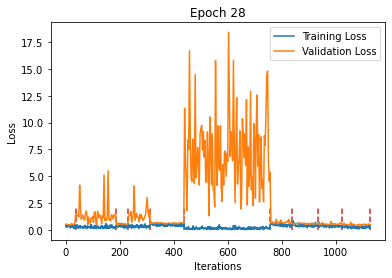

Train



Sequence:1, Seq Training Mean Loss: 0.32936250277467677, Seq Training Acc: 0.8614864864864865
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.25174777834807466, Seq Training Acc: 0.8968120805369127
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.33509092662069534, Seq Training Acc: 0.8479166666666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3104213582880703, Seq Training Acc: 0.8688271604938271
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.46773491928896566, Seq Training Acc: 0.7667322834645669
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.14103520602432998, Seq Training Acc: 0.9410377358490566
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.45054110921010737, Seq Training Acc: 0.776295731707317
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.40975726480336533, Seq Training Acc: 0.8147551546391752
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.40591499363553935, Seq Training Acc: 0.8074712643678161
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.29376072787608093, Seq Training Acc: 0.8746995192307693
******************************************************************
Epoch:29, Epoch Training Loss Mean: 0.29878270626068115, Epoch Training Acc: 0.864740461401952
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4777210478981336, Seq Valid Acc: 0.8020833333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.1513070625066757, Seq Valid Acc: 0.6325



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.4817652225494385, Seq Valid Acc: 0.81875



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.9605041433263708, Seq Valid Acc: 0.6307870370370371



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6808266582943144, Seq Valid Acc: 0.5944940476190477



******************************************************************
Sequence:6, Seq Valid Mean Loss: 5.00010356250799, Seq Valid Acc: 0.5563089622641509



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7532164366156967, Seq Valid Acc: 0.6064814814814815



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6004063757983121, Seq Valid Acc: 0.7168560606060606



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.598682918425264, Seq Valid Acc: 0.7025862068965517



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.34261489747201695, Seq Valid Acc: 0.8648897058823529
Epoch:29, Epoch Valid Mean Loss: 1.931265950202942, Epoch Valid Acc: 0.6515
******************************************************************


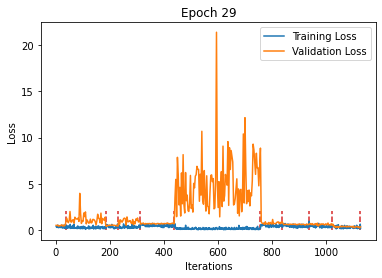

Train



Sequence:1, Seq Training Mean Loss: 0.3503614772815962, Seq Training Acc: 0.8386824324324325
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2636664365762032, Seq Training Acc: 0.889261744966443
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.34298707478576235, Seq Training Acc: 0.8493055555555555
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3159612947959959, Seq Training Acc: 0.8572530864197531
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.44032305103587355, Seq Training Acc: 0.7935531496062992
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.13566772271908303, Seq Training Acc: 0.9413325471698113
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.44929885046511164, Seq Training Acc: 0.7793445121951219
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.39551804437465277, Seq Training Acc: 0.8269974226804123
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.38240018367082224, Seq Training Acc: 0.8286637931034483
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.2562438233827169, Seq Training Acc: 0.8879206730769231
******************************************************************
Epoch:30, Epoch Training Loss Mean: 0.29056453704833984, Epoch Training Acc: 0.8694543034605147
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5902180373668671, Seq Valid Acc: 0.71875



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.2723418551683425, Seq Valid Acc: 0.645



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.4511958579222361, Seq Valid Acc: 0.8354166666666667



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.2357866366704304, Seq Valid Acc: 0.5671296296296297



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6301999375933692, Seq Valid Acc: 0.6711309523809523



******************************************************************
Sequence:6, Seq Valid Mean Loss: 4.49706700837837, Seq Valid Acc: 0.5913915094339622



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6956253449122111, Seq Valid Acc: 0.6793981481481481



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6139277436516501, Seq Valid Acc: 0.6808712121212122



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.582864995660453, Seq Valid Acc: 0.7047413793103449



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.35945333452785716, Seq Valid Acc: 0.8658088235294118
Epoch:30, Epoch Valid Mean Loss: 1.8190863132476807, Epoch Valid Acc: 0.6674166666666667
******************************************************************


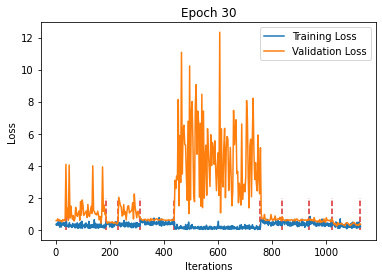

Train



Sequence:1, Seq Training Mean Loss: 0.33402273139438116, Seq Training Acc: 0.8412162162162162
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2560697043402083, Seq Training Acc: 0.8961828859060402
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3217045346895854, Seq Training Acc: 0.8604166666666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3037101893145361, Seq Training Acc: 0.8607253086419753
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4536098147940448, Seq Training Acc: 0.7768208661417323
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.1401000330283207, Seq Training Acc: 0.9392688679245284
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.42388737601477927, Seq Training Acc: 0.7884908536585366
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.38566252128365114, Seq Training Acc: 0.8208762886597938
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.40208798578415794, Seq Training Acc: 0.8135775862068966
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.2695356231326094, Seq Training Acc: 0.8837139423076923
******************************************************************
Epoch:31, Epoch Training Loss Mean: 0.2900906205177307, Epoch Training Acc: 0.8672637533274179
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4731383870045344, Seq Valid Acc: 0.8046875



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.853659685254097, Seq Valid Acc: 0.6325



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5086093962192535, Seq Valid Acc: 0.7645833333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.8816802854891177, Seq Valid Acc: 0.6203703703703703



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6367604448681786, Seq Valid Acc: 0.6473214285714286



******************************************************************
Sequence:6, Seq Valid Mean Loss: 2.8836953988615073, Seq Valid Acc: 0.6300117924528302



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7099591736440305, Seq Valid Acc: 0.6597222222222222



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.6074604265617601, Seq Valid Acc: 0.7083333333333334



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.5927070153170618, Seq Valid Acc: 0.6918103448275862



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.30607885955011144, Seq Valid Acc: 0.8841911764705882
Epoch:31, Epoch Valid Mean Loss: 1.2773895263671875, Epoch Valid Acc: 0.6794166666666667
******************************************************************


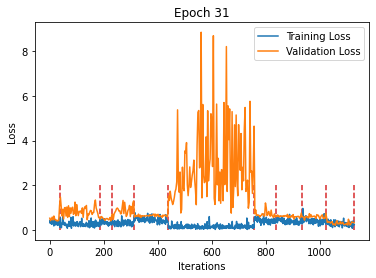

Train



Sequence:1, Seq Training Mean Loss: 0.3186254130827414, Seq Training Acc: 0.8665540540540541
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2584479880462957, Seq Training Acc: 0.8993288590604027
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.2947823441690869, Seq Training Acc: 0.86875
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.31390740915581034, Seq Training Acc: 0.8599537037037037
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.41131354070554565, Seq Training Acc: 0.8115157480314961
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.12902690279853982, Seq Training Acc: 0.9465408805031447
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.4388970202062188, Seq Training Acc: 0.7938262195121951
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.37930592049642936, Seq Training Acc: 0.8276417525773195
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.3436045263005399, Seq Training Acc: 0.8451867816091954
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.2706344437140685, Seq Training Acc: 0.8834134615384616
******************************************************************
Epoch:32, Epoch Training Loss Mean: 0.2777983844280243, Epoch Training Acc: 0.8781333185448092
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.43262062470118207, Seq Valid Acc: 0.8229166666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.262958145737648, Seq Valid Acc: 0.646875



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.48870533108711245, Seq Valid Acc: 0.8020833333333334



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.077240977022383, Seq Valid Acc: 0.6678240740740741



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.545666774113973, Seq Valid Acc: 0.7403273809523809



******************************************************************
Sequence:6, Seq Valid Mean Loss: 6.186012468248044, Seq Valid Acc: 0.5793042452830188



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7025179730521308, Seq Valid Acc: 0.6956018518518519



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.5157247565009377, Seq Valid Acc: 0.7831439393939394



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.5422549627978226, Seq Valid Acc: 0.7144396551724138



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.41375599187963147, Seq Valid Acc: 0.8318014705882353
Epoch:32, Epoch Valid Mean Loss: 2.2644553184509277, Epoch Valid Acc: 0.6890833333333334
******************************************************************


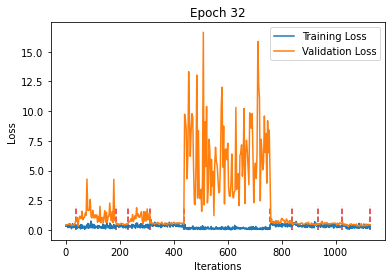

Train



Sequence:1, Seq Training Mean Loss: 0.3071784207949767, Seq Training Acc: 0.8716216216216216
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.24275063733326507, Seq Training Acc: 0.902265100671141
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3310601979494095, Seq Training Acc: 0.8506944444444444
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3129581555172249, Seq Training Acc: 0.8622685185185185
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4290482968561293, Seq Training Acc: 0.7903543307086615
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.12876597362271738, Seq Training Acc: 0.9465408805031447
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.4384894600001777, Seq Training Acc: 0.7842987804878049
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.3917278303313501, Seq Training Acc: 0.8173324742268041
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.374705638693667, Seq Training Acc: 0.8247126436781609
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.25480092861331427, Seq Training Acc: 0.8825120192307693
******************************************************************
Epoch:33, Epoch Training Loss Mean: 0.2806316912174225, Epoch Training Acc: 0.8725044365572315
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.42094068974256516, Seq Valid Acc: 0.8307291666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.9373353350162507, Seq Valid Acc: 0.626875



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.49016265869140624, Seq Valid Acc: 0.7895833333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.8411360449261136, Seq Valid Acc: 0.6203703703703703



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6168965796629587, Seq Valid Acc: 0.6741071428571429



******************************************************************
Sequence:6, Seq Valid Mean Loss: 3.741781578873688, Seq Valid Acc: 0.5527712264150944



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.683687064382765, Seq Valid Acc: 0.6770833333333334



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.5692243016127384, Seq Valid Acc: 0.740530303030303



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.5786188491459551, Seq Valid Acc: 0.6918103448275862



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.32258839160203934, Seq Valid Acc: 0.8795955882352942
Epoch:33, Epoch Valid Mean Loss: 1.5186976194381714, Epoch Valid Acc: 0.6653333333333333
******************************************************************


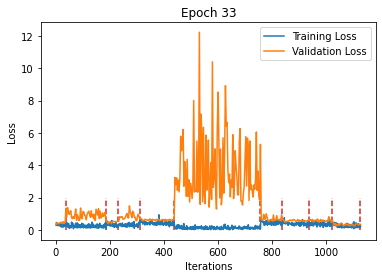

Train



Sequence:1, Seq Training Mean Loss: 0.2954347628999401, Seq Training Acc: 0.8733108108108109
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.24448571494161683, Seq Training Acc: 0.9018456375838926
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.31725699835353427, Seq Training Acc: 0.85625
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.279641130640183, Seq Training Acc: 0.8773148148148148
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4132455992182409, Seq Training Acc: 0.8026574803149606
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.12890977008010512, Seq Training Acc: 0.9466391509433962
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.42765796493466307, Seq Training Acc: 0.7865853658536586
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.3827199670918209, Seq Training Acc: 0.8295747422680413
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.3524744403602063, Seq Training Acc: 0.8362068965517241
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.2535821095538827, Seq Training Acc: 0.8942307692307693
******************************************************************
Epoch:34, Epoch Training Loss Mean: 0.27239757776260376, Epoch Training Acc: 0.8784106033717834
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3730961854259173, Seq Valid Acc: 0.8411458333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.9860330331325531, Seq Valid Acc: 0.6475



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.42415061791737874, Seq Valid Acc: 0.8291666666666667



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.076347702079349, Seq Valid Acc: 0.6053240740740741



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6568342135066078, Seq Valid Acc: 0.6346726190476191



******************************************************************
Sequence:6, Seq Valid Mean Loss: 5.681544633406513, Seq Valid Acc: 0.6105542452830188



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7791143479170622, Seq Valid Acc: 0.6608796296296297



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.5818101872097362, Seq Valid Acc: 0.7140151515151515



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.5053170477521831, Seq Valid Acc: 0.7607758620689655



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.2739264588145649, Seq Valid Acc: 0.8795955882352942
Epoch:34, Epoch Valid Mean Loss: 2.0886311531066895, Epoch Valid Acc: 0.6826666666666666
******************************************************************


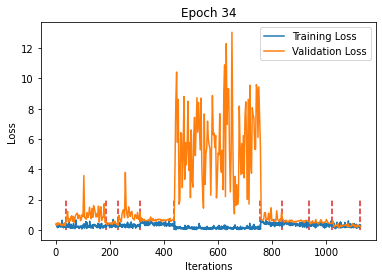

Train



Sequence:1, Seq Training Mean Loss: 0.29890369885676615, Seq Training Acc: 0.856418918918919
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2390195441326039, Seq Training Acc: 0.9035234899328859
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3255809893210729, Seq Training Acc: 0.8506944444444444
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3275930444583481, Seq Training Acc: 0.8491512345679012
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4114708072087896, Seq Training Acc: 0.8031496062992126
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.12544400393728566, Seq Training Acc: 0.945066823899371
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.4184865976979093, Seq Training Acc: 0.7865853658536586
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.36476962821385295, Seq Training Acc: 0.8411726804123711
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.3537860348306853, Seq Training Acc: 0.8415948275862069
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.2530663445806847, Seq Training Acc: 0.8828125
******************************************************************
Epoch:35, Epoch Training Loss Mean: 0.27223101258277893, Epoch Training Acc: 0.8758041259982253
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3411921349664529, Seq Valid Acc: 0.8697916666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.0134685933589935, Seq Valid Acc: 0.631875



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.4701293190320333, Seq Valid Acc: 0.8083333333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.9540018991187766, Seq Valid Acc: 0.6296296296296297



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6386886891864595, Seq Valid Acc: 0.6555059523809523



******************************************************************
Sequence:6, Seq Valid Mean Loss: 5.4704044298181, Seq Valid Acc: 0.6140919811320755



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.686078632319415, Seq Valid Acc: 0.6516203703703703



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.5984314409169283, Seq Valid Acc: 0.7035984848484849



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.5627587458183025, Seq Valid Acc: 0.7381465517241379



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.24444715240422418, Seq Valid Acc: 0.9154411764705882
Epoch:35, Epoch Valid Mean Loss: 2.019117593765259, Epoch Valid Acc: 0.6856666666666666
******************************************************************


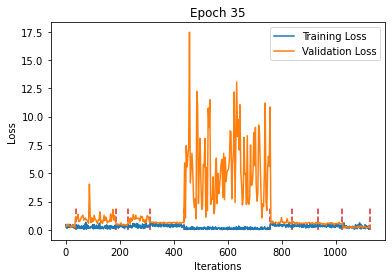

Train



Sequence:1, Seq Training Mean Loss: 0.28920277187953125, Seq Training Acc: 0.8851351351351351
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.24156081046434058, Seq Training Acc: 0.8982802013422819
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3153347571690877, Seq Training Acc: 0.8569444444444444
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.2922141541853363, Seq Training Acc: 0.8707561728395061
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.37325277572541726, Seq Training Acc: 0.8250492125984252
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.12107363048905753, Seq Training Acc: 0.9490959119496856
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.4134655502147791, Seq Training Acc: 0.7961128048780488
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.3556094009851672, Seq Training Acc: 0.8398840206185567
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.3563624125445026, Seq Training Acc: 0.8466235632183908
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.25038497275314653, Seq Training Acc: 0.8885216346153846
******************************************************************
Epoch:36, Epoch Training Loss Mean: 0.26255443692207336, Epoch Training Acc: 0.8829580745341615
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4370717356602351, Seq Valid Acc: 0.796875



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.7633383762836456, Seq Valid Acc: 0.640625



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.4383908669153849, Seq Valid Acc: 0.8229166666666666



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.3723465027632538, Seq Valid Acc: 0.6307870370370371



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6006504864919753, Seq Valid Acc: 0.6919642857142857



******************************************************************
Sequence:6, Seq Valid Mean Loss: 7.642588235297293, Seq Valid Acc: 0.5557193396226415



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7326359362513931, Seq Valid Acc: 0.6759259259259259



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.5750341794707559, Seq Valid Acc: 0.7178030303030303



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.49587392087640436, Seq Valid Acc: 0.7844827586206896



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.29816384306725335, Seq Valid Acc: 0.8768382352941176
Epoch:36, Epoch Valid Mean Loss: 2.7617545127868652, Epoch Valid Acc: 0.6758333333333333
******************************************************************


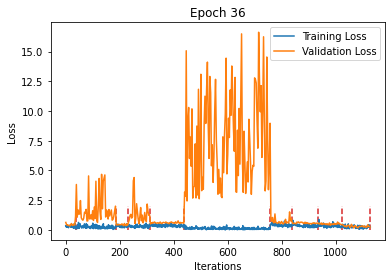

Train



Sequence:1, Seq Training Mean Loss: 0.2752695492393262, Seq Training Acc: 0.8775337837837838
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.22107790570531116, Seq Training Acc: 0.9052013422818792
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.297752688659562, Seq Training Acc: 0.8604166666666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.2984523712484925, Seq Training Acc: 0.8622685185185185
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3957233167304767, Seq Training Acc: 0.8171751968503937
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.12054581118530869, Seq Training Acc: 0.9475235849056604
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.39720122570671684, Seq Training Acc: 0.807545731707317
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.3371844350062695, Seq Training Acc: 0.8485824742268041
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.34455591405945263, Seq Training Acc: 0.8473419540229885
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.22838898898603824, Seq Training Acc: 0.9017427884615384
******************************************************************
Epoch:37, Epoch Training Loss Mean: 0.2558080852031708, Epoch Training Acc: 0.884677240461402
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4541690821448962, Seq Valid Acc: 0.7942708333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.336609308719635, Seq Valid Acc: 0.6425



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.4241779049237569, Seq Valid Acc: 0.8458333333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.2991283613222617, Seq Valid Acc: 0.6099537037037037



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6394766994885036, Seq Valid Acc: 0.640625



******************************************************************
Sequence:6, Seq Valid Mean Loss: 6.018761912606797, Seq Valid Acc: 0.5681014150943396



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.7262566486994425, Seq Valid Acc: 0.7048611111111112



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.5957046060851126, Seq Valid Acc: 0.6884469696969697



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.550902101500281, Seq Valid Acc: 0.7370689655172413



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.24800829414059133, Seq Valid Acc: 0.9126838235294118
Epoch:37, Epoch Valid Mean Loss: 2.245978832244873, Epoch Valid Acc: 0.67225
******************************************************************


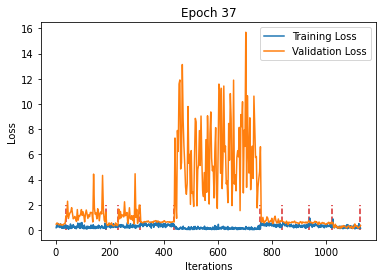

Train



Sequence:1, Seq Training Mean Loss: 0.27913723845739624, Seq Training Acc: 0.8800675675675675
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.23144628270060424, Seq Training Acc: 0.9039429530201343
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.31099786261717477, Seq Training Acc: 0.8576388888888888
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.2759228946618092, Seq Training Acc: 0.8761574074074074
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3935412823215244, Seq Training Acc: 0.812746062992126
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.11899989590037076, Seq Training Acc: 0.9486045597484277
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.4185218562076731, Seq Training Acc: 0.7961128048780488
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.356553859624666, Seq Training Acc: 0.8405283505154639
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.3448980034425341, Seq Training Acc: 0.8473419540229885
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.23491214154861295, Seq Training Acc: 0.8969350961538461
******************************************************************
Epoch:38, Epoch Training Loss Mean: 0.25938019156455994, Epoch Training Acc: 0.883318544809228
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.40438445657491684, Seq Valid Acc: 0.8671875



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.5033744025230407, Seq Valid Acc: 0.62625



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.42513667345046996, Seq Valid Acc: 0.8229166666666666



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.674228133978667, Seq Valid Acc: 0.5833333333333334



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6352365343343644, Seq Valid Acc: 0.6629464285714286



******************************************************************
Sequence:6, Seq Valid Mean Loss: 8.332197842732915, Seq Valid Acc: 0.5760613207547169



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.65143965460636, Seq Valid Acc: 0.7025462962962963



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.5307834446430206, Seq Valid Acc: 0.7746212121212122



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.5491731577906115, Seq Valid Acc: 0.7532327586206896



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.21729185826638164, Seq Valid Acc: 0.9117647058823529
Epoch:38, Epoch Valid Mean Loss: 2.9331042766571045, Epoch Valid Acc: 0.6829166666666666
******************************************************************


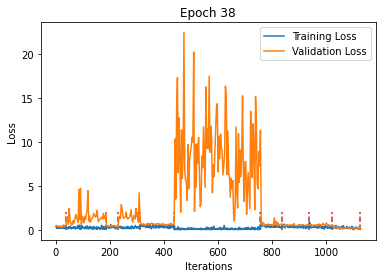

Train



Sequence:1, Seq Training Mean Loss: 0.25970423906236084, Seq Training Acc: 0.8851351351351351
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.24818414432190408, Seq Training Acc: 0.8980704697986577
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.321037158370018, Seq Training Acc: 0.8520833333333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.30813185925836917, Seq Training Acc: 0.8591820987654321
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3859054351768156, Seq Training Acc: 0.8196358267716536
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.12474639767212735, Seq Training Acc: 0.94437893081761
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.4088589056599431, Seq Training Acc: 0.7980182926829268
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.3207459089528654, Seq Training Acc: 0.8569587628865979
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.3315987878147213, Seq Training Acc: 0.8548850574712644
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.2348005838978749, Seq Training Acc: 0.8993389423076923
******************************************************************
Epoch:39, Epoch Training Loss Mean: 0.2596098780632019, Epoch Training Acc: 0.8832076308784383
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.36172518009940785, Seq Valid Acc: 0.8385416666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.168765069246292, Seq Valid Acc: 0.66375



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.44437763293584187, Seq Valid Acc: 0.8229166666666666



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.3679413464334276, Seq Valid Acc: 0.6111111111111112



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5443585933673949, Seq Valid Acc: 0.7447916666666666



******************************************************************
Sequence:6, Seq Valid Mean Loss: 5.66162104370459, Seq Valid Acc: 0.5613207547169812



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.5923834994987205, Seq Valid Acc: 0.7337962962962963



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.47732124545357446, Seq Valid Acc: 0.8115530303030303



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.48652762893972723, Seq Valid Acc: 0.7801724137931034



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.3016054406762123, Seq Valid Acc: 0.8851102941176471
Epoch:39, Epoch Valid Mean Loss: 2.094623565673828, Epoch Valid Acc: 0.6991666666666667
******************************************************************


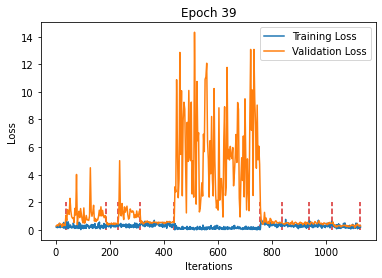

Train



Sequence:1, Seq Training Mean Loss: 0.2732948487674868, Seq Training Acc: 0.879222972972973
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.22820499069338676, Seq Training Acc: 0.9096057046979866
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.27905964685810936, Seq Training Acc: 0.88125
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.2912036978904112, Seq Training Acc: 0.8734567901234568
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.38390037945405703, Seq Training Acc: 0.8203740157480315
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.1179225093175499, Seq Training Acc: 0.9500786163522013
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.4037855720011199, Seq Training Acc: 0.7995426829268293
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.332633901349048, Seq Training Acc: 0.8518041237113402
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.32867144493536016, Seq Training Acc: 0.8477011494252874
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.2347214145299334, Seq Training Acc: 0.9017427884615384
******************************************************************
Epoch:40, Epoch Training Loss Mean: 0.2527911961078644, Epoch Training Acc: 0.8877551020408163
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4139638418952624, Seq Valid Acc: 0.8411458333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.3206822347640992, Seq Valid Acc: 0.62625



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.44144394795099895, Seq Valid Acc: 0.85



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.241117004994993, Seq Valid Acc: 0.6354166666666666



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5910431033089047, Seq Valid Acc: 0.703125



******************************************************************
Sequence:6, Seq Valid Mean Loss: 4.554662499787672, Seq Valid Acc: 0.5710495283018868



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6209504858211234, Seq Valid Acc: 0.71875



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.5061388801444661, Seq Valid Acc: 0.7755681818181818



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.5293756990597166, Seq Valid Acc: 0.740301724137931



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.27626003368812446, Seq Valid Acc: 0.8878676470588235
Epoch:40, Epoch Valid Mean Loss: 1.8052387237548828, Epoch Valid Acc: 0.6880833333333334
******************************************************************


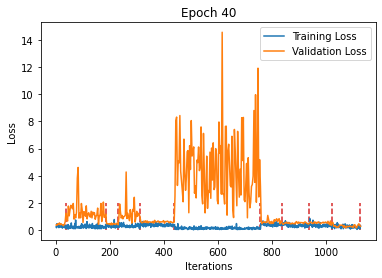

Train



Sequence:1, Seq Training Mean Loss: 0.27514808927033396, Seq Training Acc: 0.8614864864864865
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.21697897314025252, Seq Training Acc: 0.9110738255033557
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.27557671732372707, Seq Training Acc: 0.8743055555555556
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.2880910322713999, Seq Training Acc: 0.8726851851851852
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3804157673139272, Seq Training Acc: 0.8255413385826772
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.1257197508272135, Seq Training Acc: 0.9434944968553459
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3875654159886081, Seq Training Acc: 0.8086890243902439
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.3327662587626693, Seq Training Acc: 0.8569587628865979
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.315822104784264, Seq Training Acc: 0.8595545977011494
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.19921389820340735, Seq Training Acc: 0.9167668269230769
******************************************************************
Epoch:41, Epoch Training Loss Mean: 0.24737516045570374, Epoch Training Acc: 0.8891692546583851
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4047231723864873, Seq Valid Acc: 0.8359375



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.1427188533544541, Seq Valid Acc: 0.63



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.4072687983512878, Seq Valid Acc: 0.8479166666666667



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.1415298139607464, Seq Valid Acc: 0.6168981481481481



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5825365625676655, Seq Valid Acc: 0.7001488095238095



******************************************************************
Sequence:6, Seq Valid Mean Loss: 3.8664103723921865, Seq Valid Acc: 0.5972877358490566



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6911858728638401, Seq Valid Acc: 0.6932870370370371



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.47990110787478363, Seq Valid Acc: 0.7774621212121212



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.4742081052270429, Seq Valid Acc: 0.7780172413793104



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.2498313276206746, Seq Valid Acc: 0.8988970588235294
Epoch:41, Epoch Valid Mean Loss: 1.5732641220092773, Epoch Valid Acc: 0.6963333333333334
******************************************************************


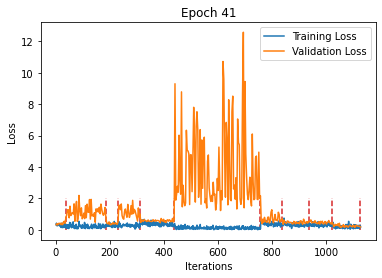

Train



Sequence:1, Seq Training Mean Loss: 0.244007697782001, Seq Training Acc: 0.8902027027027027
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.21820627715463606, Seq Training Acc: 0.910234899328859
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.28718670705954236, Seq Training Acc: 0.8708333333333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.29342594025311647, Seq Training Acc: 0.8641975308641975
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.38489485807775514, Seq Training Acc: 0.8184055118110236
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.11774953463079654, Seq Training Acc: 0.9486045597484277
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3849159639056136, Seq Training Acc: 0.8136432926829268
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.34903147709123866, Seq Training Acc: 0.8405283505154639
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.31497593361070786, Seq Training Acc: 0.8624281609195402
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.22166679025842592, Seq Training Acc: 0.9029447115384616
******************************************************************
Epoch:42, Epoch Training Loss Mean: 0.24883171916007996, Epoch Training Acc: 0.8877828305235137
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3930547883113225, Seq Valid Acc: 0.8541666666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.2048530626296996, Seq Valid Acc: 0.66625



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.4469779868920644, Seq Valid Acc: 0.80625



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.2514386817261025, Seq Valid Acc: 0.6261574074074074



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5742311981462297, Seq Valid Acc: 0.7239583333333334



******************************************************************
Sequence:6, Seq Valid Mean Loss: 4.657489321141873, Seq Valid Acc: 0.5766509433962265



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6894192894299825, Seq Valid Acc: 0.7222222222222222



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.47208746725862677, Seq Valid Acc: 0.8011363636363636



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.4216734705300167, Seq Valid Acc: 0.8135775862068966



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.26229819304802837, Seq Valid Acc: 0.8933823529411765
Epoch:42, Epoch Valid Mean Loss: 1.8096113204956055, Epoch Valid Acc: 0.704
******************************************************************


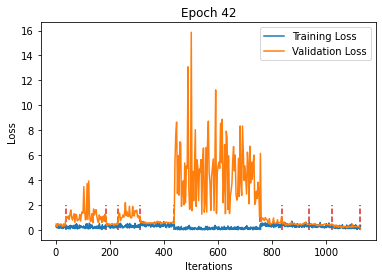

Train



Sequence:1, Seq Training Mean Loss: 0.2959585737537693, Seq Training Acc: 0.8724662162162162
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.22625038647811685, Seq Training Acc: 0.9077181208053692
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.2720364424917433, Seq Training Acc: 0.8756944444444444
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.289634002763548, Seq Training Acc: 0.8719135802469136
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.35757452742321283, Seq Training Acc: 0.8358759842519685
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.11583973407897653, Seq Training Acc: 0.9500786163522013
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.38122566117019185, Seq Training Acc: 0.8125
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.34873519530615854, Seq Training Acc: 0.8469716494845361
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.30011079734426804, Seq Training Acc: 0.8674568965517241
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.21120046609296247, Seq Training Acc: 0.9107572115384616
******************************************************************
Epoch:43, Epoch Training Loss Mean: 0.2446983903646469, Epoch Training Acc: 0.8915816326530612
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.40541089077790576, Seq Valid Acc: 0.828125



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.819541972875595, Seq Valid Acc: 0.6525



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.4165993432203929, Seq Valid Acc: 0.8145833333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.1335992680655584, Seq Valid Acc: 0.6157407407407407



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.572290416274752, Seq Valid Acc: 0.7075892857142857



******************************************************************
Sequence:6, Seq Valid Mean Loss: 3.214401551012723, Seq Valid Acc: 0.6129127358490566



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6738079797338556, Seq Valid Acc: 0.6840277777777778



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.47247119654308667, Seq Valid Acc: 0.7916666666666666



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.4867346831436815, Seq Valid Acc: 0.7758620689655172



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.2495195878779187, Seq Valid Acc: 0.9016544117647058
Epoch:43, Epoch Valid Mean Loss: 1.3435848951339722, Epoch Valid Acc: 0.7035833333333333
******************************************************************


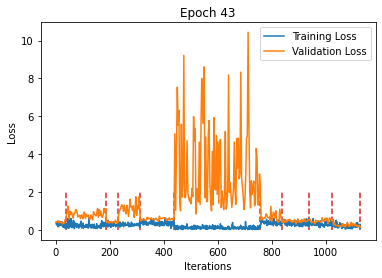

Train



Sequence:1, Seq Training Mean Loss: 0.26011361342829625, Seq Training Acc: 0.8859797297297297
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.24310998356082295, Seq Training Acc: 0.8993288590604027
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.273625409271982, Seq Training Acc: 0.8840277777777777
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.2958509739902284, Seq Training Acc: 0.8692129629629629
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3728594492504916, Seq Training Acc: 0.827755905511811
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.10599115154992952, Seq Training Acc: 0.9539111635220126
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.37521136115963866, Seq Training Acc: 0.8159298780487805
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.3419500520241629, Seq Training Acc: 0.8469716494845361
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.32776499839349726, Seq Training Acc: 0.858117816091954
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.2098182739260105, Seq Training Acc: 0.9086538461538461
******************************************************************
Epoch:44, Epoch Training Loss Mean: 0.24619001150131226, Epoch Training Acc: 0.8905556787932565
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3943411608537038, Seq Valid Acc: 0.8046875



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.8975978660583496, Seq Valid Acc: 0.63375



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.3975754121939341, Seq Valid Acc: 0.8458333333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.2785205399548565, Seq Valid Acc: 0.6215277777777778



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5212429286468596, Seq Valid Acc: 0.7738095238095238



******************************************************************
Sequence:6, Seq Valid Mean Loss: 3.2289068552682982, Seq Valid Acc: 0.620872641509434



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.6271955845532594, Seq Valid Acc: 0.7465277777777778



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.4581957721348965, Seq Valid Acc: 0.8210227272727273



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.4425168787610942, Seq Valid Acc: 0.8135775862068966



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.2772363866953289, Seq Valid Acc: 0.8961397058823529
Epoch:44, Epoch Valid Mean Loss: 1.356175422668457, Epoch Valid Acc: 0.7211666666666666
******************************************************************


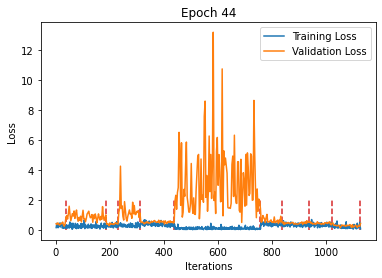

Train



Sequence:1, Seq Training Mean Loss: 0.2932486741526707, Seq Training Acc: 0.875
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.22204020351871548, Seq Training Acc: 0.9091862416107382
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.2577486586239603, Seq Training Acc: 0.8916666666666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.27092904993045475, Seq Training Acc: 0.8800154320987654
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.375514561383743, Seq Training Acc: 0.8218503937007874
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.10686342105702878, Seq Training Acc: 0.9537146226415094
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.379110740088835, Seq Training Acc: 0.8140243902439024
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.32945610767172784, Seq Training Acc: 0.8492268041237113
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.30174627763101425, Seq Training Acc: 0.8645833333333334
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.21376288277455247, Seq Training Acc: 0.9119591346153846
******************************************************************
Epoch:45, Epoch Training Loss Mean: 0.240176260471344, Epoch Training Acc: 0.8927185004436557
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.39507675915956497, Seq Valid Acc: 0.8385416666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.8580200773477554, Seq Valid Acc: 0.655



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.41112168232599894, Seq Valid Acc: 0.8354166666666667



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.3017933302455478, Seq Valid Acc: 0.6203703703703703



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5493246366580328, Seq Valid Acc: 0.734375



******************************************************************
Sequence:6, Seq Valid Mean Loss: 2.6896128598249183, Seq Valid Acc: 0.6158608490566038



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.627960212804653, Seq Valid Acc: 0.7245370370370371



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.45164629546078766, Seq Valid Acc: 0.8172348484848485



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.4919258489690978, Seq Valid Acc: 0.771551724137931



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.22148544122191036, Seq Valid Acc: 0.9071691176470589
Epoch:45, Epoch Valid Mean Loss: 1.2020890712738037, Epoch Valid Acc: 0.7145833333333333
******************************************************************


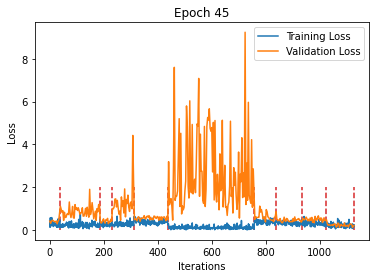

Train



Sequence:1, Seq Training Mean Loss: 0.28608564710294876, Seq Training Acc: 0.875
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2141203838556805, Seq Training Acc: 0.9182046979865772
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.31800984607802496, Seq Training Acc: 0.8645833333333334
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.2746625820427765, Seq Training Acc: 0.8719135802469136
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3692390550309279, Seq Training Acc: 0.8265255905511811
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.10537858362420925, Seq Training Acc: 0.9526336477987422
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3757257739581713, Seq Training Acc: 0.8163109756097561
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.3356449287576774, Seq Training Acc: 0.8440721649484536
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.31751348806181173, Seq Training Acc: 0.8617097701149425
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.21687267527270776, Seq Training Acc: 0.9098557692307693
******************************************************************
Epoch:46, Epoch Training Loss Mean: 0.24223288893699646, Epoch Training Acc: 0.8917757320319432
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.37493834892908734, Seq Valid Acc: 0.859375



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.8894096446037293, Seq Valid Acc: 0.6675



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.428130441904068, Seq Valid Acc: 0.8



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.2014253890072857, Seq Valid Acc: 0.625



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5518862072910581, Seq Valid Acc: 0.7090773809523809



******************************************************************
Sequence:6, Seq Valid Mean Loss: 3.2736566932696216, Seq Valid Acc: 0.6164504716981132



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.5774287559367992, Seq Valid Acc: 0.7326388888888888



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.43437113816087897, Seq Valid Acc: 0.8200757575757576



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.44657494692966854, Seq Valid Acc: 0.7952586206896551



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.2758919465191224, Seq Valid Acc: 0.8869485294117647
Epoch:46, Epoch Valid Mean Loss: 1.3607276678085327, Epoch Valid Acc: 0.714
******************************************************************


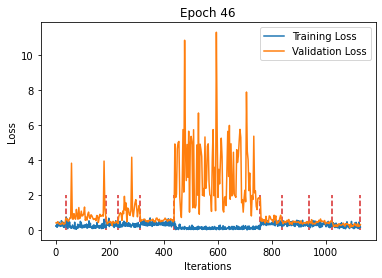

Train



Sequence:1, Seq Training Mean Loss: 0.2844055866872942, Seq Training Acc: 0.8766891891891891
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.21129465943214878, Seq Training Acc: 0.9158976510067114
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.30915686223242017, Seq Training Acc: 0.8652777777777778
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.2731854484221082, Seq Training Acc: 0.8761574074074074
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.38997477926607205, Seq Training Acc: 0.8154527559055118
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.11252530417610077, Seq Training Acc: 0.9506682389937107
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.38841040850412556, Seq Training Acc: 0.807545731707317
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.3368818186914798, Seq Training Acc: 0.8495489690721649
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.3312217312297602, Seq Training Acc: 0.8498563218390804
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.2238613458421941, Seq Training Acc: 0.9077524038461539
******************************************************************
Epoch:47, Epoch Training Loss Mean: 0.2484302520751953, Epoch Training Acc: 0.8887810559006211
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4275199274222056, Seq Valid Acc: 0.8307291666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.8967719179391861, Seq Valid Acc: 0.64625



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.39709038734436036, Seq Valid Acc: 0.8583333333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.3257331958523504, Seq Valid Acc: 0.5972222222222222



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5028154587461835, Seq Valid Acc: 0.7708333333333334



******************************************************************
Sequence:6, Seq Valid Mean Loss: 3.8360559673241847, Seq Valid Acc: 0.6079009433962265



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.5480141617633678, Seq Valid Acc: 0.7534722222222222



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.45120970679051947, Seq Valid Acc: 0.8039772727272727



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.45414896360759077, Seq Valid Acc: 0.7823275862068966



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.27008183563456817, Seq Valid Acc: 0.8915441176470589
Epoch:47, Epoch Valid Mean Loss: 1.5239988565444946, Epoch Valid Acc: 0.7145833333333333
******************************************************************


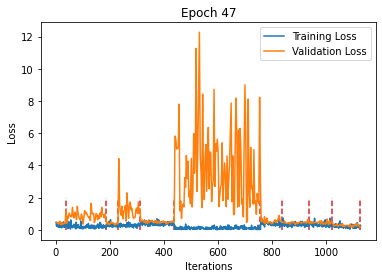

Train



Sequence:1, Seq Training Mean Loss: 0.3167724206640914, Seq Training Acc: 0.8665540540540541
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.22061081098130086, Seq Training Acc: 0.9098154362416108
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.28968758516841464, Seq Training Acc: 0.8729166666666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.2742561201254527, Seq Training Acc: 0.876929012345679
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.36238550776102413, Seq Training Acc: 0.828494094488189
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.10384183164258376, Seq Training Acc: 0.9537146226415094
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.38898630930883127, Seq Training Acc: 0.8109756097560976
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.3378220656790684, Seq Training Acc: 0.8505154639175257
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.3120207992093316, Seq Training Acc: 0.8595545977011494
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.20165464618744758, Seq Training Acc: 0.9194711538461539
******************************************************************
Epoch:48, Epoch Training Loss Mean: 0.24105632305145264, Epoch Training Acc: 0.8924966725820763
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4229828367630641, Seq Valid Acc: 0.828125



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.8518029832839966, Seq Valid Acc: 0.66625



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.3980885644753774, Seq Valid Acc: 0.8395833333333333



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.3169491092363994, Seq Valid Acc: 0.5949074074074074



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5103940360602879, Seq Valid Acc: 0.7678571428571429



******************************************************************
Sequence:6, Seq Valid Mean Loss: 3.7301334749977544, Seq Valid Acc: 0.6040683962264151



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.5464949972099729, Seq Valid Acc: 0.7638888888888888



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.45766463695150433, Seq Valid Acc: 0.7945075757575758



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.43290178323614187, Seq Valid Acc: 0.7898706896551724



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.28056658015531655, Seq Valid Acc: 0.8823529411764706
Epoch:48, Epoch Valid Mean Loss: 1.4879395961761475, Epoch Valid Acc: 0.7145
******************************************************************


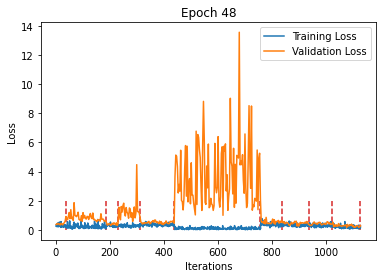

Train



Sequence:1, Seq Training Mean Loss: 0.26164292644810033, Seq Training Acc: 0.8817567567567568
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.22239405946843577, Seq Training Acc: 0.9058305369127517
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3112103521823883, Seq Training Acc: 0.8618055555555556
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.27271805630054, Seq Training Acc: 0.8773148148148148
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3566029833292398, Seq Training Acc: 0.8348917322834646
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.11038579490129491, Seq Training Acc: 0.953812893081761
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.39969796869086055, Seq Training Acc: 0.8048780487804879
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.3346485025489453, Seq Training Acc: 0.8447164948453608
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.3293142332427803, Seq Training Acc: 0.8469827586206896
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.2159743235231592, Seq Training Acc: 0.9080528846153846
******************************************************************
Epoch:49, Epoch Training Loss Mean: 0.2445884495973587, Epoch Training Acc: 0.8898347382431233
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.40233515202999115, Seq Valid Acc: 0.8229166666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.9424693471193314, Seq Valid Acc: 0.639375



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.43711995681126914, Seq Valid Acc: 0.7916666666666666



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.5285542651459023, Seq Valid Acc: 0.6111111111111112



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5129142793871108, Seq Valid Acc: 0.7529761904761905



******************************************************************
Sequence:6, Seq Valid Mean Loss: 4.267358384042416, Seq Valid Acc: 0.6114386792452831



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.5167724302521458, Seq Valid Acc: 0.7858796296296297



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.40171888290029584, Seq Valid Acc: 0.8295454545454546



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.3912872261014478, Seq Valid Acc: 0.822198275862069



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.2744916160317028, Seq Valid Acc: 0.8832720588235294
Epoch:49, Epoch Valid Mean Loss: 1.6574701070785522, Epoch Valid Acc: 0.7176666666666667
******************************************************************


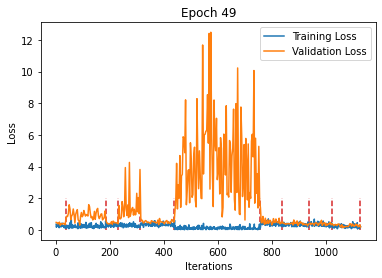

Train



Sequence:1, Seq Training Mean Loss: 0.29770960397011526, Seq Training Acc: 0.8673986486486487
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.23475908555540462, Seq Training Acc: 0.9075083892617449
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3093459145890342, Seq Training Acc: 0.8611111111111112
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.279416535463598, Seq Training Acc: 0.875
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.36100530952919185, Seq Training Acc: 0.8356299212598425
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.11039058257439086, Seq Training Acc: 0.9514544025157232
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.40055212051403233, Seq Training Acc: 0.7999237804878049
******************************************************************



Sequence:8, Seq Training Mean Loss: 0.321054521141593, Seq Training Acc: 0.8585695876288659
******************************************************************



Sequence:9, Seq Training Mean Loss: 0.3446817905053325, Seq Training Acc: 0.8441091954022989
******************************************************************



Sequence:10, Seq Training Mean Loss: 0.2324459427394546, Seq Training Acc: 0.9020432692307693
******************************************************************
Epoch:50, Epoch Training Loss Mean: 0.24991020560264587, Epoch Training Acc: 0.8888642413487134
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4152063578367233, Seq Valid Acc: 0.8177083333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.8183204346895218, Seq Valid Acc: 0.6675



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.3998039106527964, Seq Valid Acc: 0.825



******************************************************************
Sequence:4, Seq Valid Mean Loss: 1.2642057913321036, Seq Valid Acc: 0.6111111111111112



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.457292147335552, Seq Valid Acc: 0.7872023809523809



******************************************************************
Sequence:6, Seq Valid Mean Loss: 4.097004955107311, Seq Valid Acc: 0.6079009433962265



******************************************************************
Sequence:7, Seq Valid Mean Loss: 0.457112580537796, Seq Valid Acc: 0.7800925925925926



******************************************************************
Sequence:8, Seq Valid Mean Loss: 0.38457451444683655, Seq Valid Acc: 0.8399621212121212



******************************************************************
Sequence:9, Seq Valid Mean Loss: 0.44385082968350115, Seq Valid Acc: 0.7898706896551724



******************************************************************
Sequence:10, Seq Valid Mean Loss: 0.3956207869683995, Seq Valid Acc: 0.8216911764705882
Epoch:50, Epoch Valid Mean Loss: 1.5756630897521973, Epoch Valid Acc: 0.7178333333333333
******************************************************************


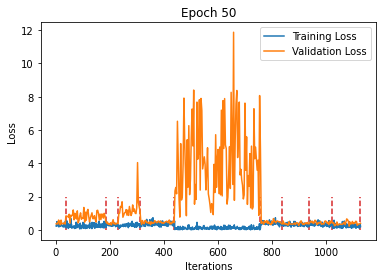


Save Model
Finished Training


In [30]:
if run_train:
    writer = SummaryWriter('runs/008_ResNet34_alldata_2e-4')
    max_iter_per_seq = 600
    # 训练迭代总步数
    num_train_iter_per_epoch = 0
    num_train_iterations = [] # For plot parting line
    num_train_iterations_per_dl = [max_iter_per_seq if len(dl)>= max_iter_per_seq else len(dl) for dl in train_dls]
    for seq_dataloaders in dataloaders:
        if len(seq_dataloaders[train_dl_idx]) <= max_iter_per_seq:
            num_train_iter_per_epoch += len(seq_dataloaders[train_dl_idx])
        else:
            num_train_iter_per_epoch += max_iter_per_seq
        num_train_iterations.append(num_train_iter_per_epoch)
    print("Total Train Iterations: ",num_train_iter_per_epoch)
    print("Total Train Iterations List: ",num_train_iterations)
        
    # 训练迭代总步数为验证迭代总步数的3倍
    num_val_iterations = [int(number / 3) for number in num_train_iterations]
    num_val_iter_per_epoch = num_val_iterations[-1]
    
    # iterations in every seq
    num_val_iter_per_seq = []
    num_val_iter_per_seq.append(num_val_iterations[0])
    for i in range(len(num_val_iterations)-1):
        diff = num_val_iterations[i+1] - num_val_iterations[i] # The latter minus the former
        num_val_iter_per_seq.append(diff)
        
    print("Valid iterations per seq: ",num_val_iter_per_seq)
        
    optimizer = torch.optim.Adam(model.parameters(),lr=lr,eps=1e-08)

    scheduler = OneCycleLR(optimizer, num_train_iter_per_epoch, num_epochs, min_lr_factor=min_lr_factor)
    scheduler.step(epoch=0)
    
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.
    loss_min = 0.
    
    for epoch in tqdm(range(1,num_epochs+1)):

        print('Train')

        model.train()
        
        running_corrects = 0

        train_loss_array = np.zeros(num_train_iter_per_epoch, dtype=np.single)

        # mse_y = torch.zeros(batch_sizes[0]//2).to(device)
        
        i = 0
        seq_idx = 1
        for (refs, train_dl, max_num) in zip(refs_list, train_dls, num_train_iterations_per_dl):
            # obtain the refs in every seq
            
            curr_train_dl = train_dl

            curr_refs = refs.float().to(device)

            # Training
            dl_iter = iter(curr_train_dl)
            
            # This two only used to compute the loss and acc in every Sequence
            running_loss = 0
            corrects = 0
            for idx in tqdm(range(max_num)):
                if idx >= max_iter_per_seq:
                    break
                try:
                    img1, img2, targets = next(dl_iter)

                except (StopIteration, TypeError):
                    dl_iter = iter(curr_train_dl)
                    img1, img2, targets = next(dl_iter)
                
                scheduler.zero_grad()

                img1 = img1.float().to(device)
                img2 = img2.float().to(device)
                targets = targets.view(-1)
                targets = targets.float().to(device)

                # forward pass
                loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                
                loss.backward()
                
                running_loss += loss.item()
                corrects += torch.sum(preds == targets)
                running_corrects += torch.sum(preds == targets)

                train_loss_array[i] = loss.cpu().detach().numpy()
               
                
                # record loss and accuracy per iteration
                c = torch.sum(preds == targets)
                acc = int(c) / img1.size(0)
                writer.add_scalar('Train/Loss per Iteration',train_loss_array[i], ((epoch - 1) * num_train_iter_per_epoch)+ i)
                writer.add_scalar('Train/Acc per Iteration',acc, ((epoch - 1) * num_train_iter_per_epoch)+ i)
                
                # Record the lr
                curr_lr = get_lr(optimizer)
                writer.add_scalar('Train/Learning Rate',curr_lr , ((epoch - 1) * num_train_iter_per_epoch)+ i)
                
                i += 1
                scheduler.step()
            
            # record loss and accuracy in every train dataloader (namely every Sequence)
            #seq_train_mean_loss = running_loss / len(curr_train_dl)
            #seq_train_acc = int(corrects) / (len(curr_train_dl) * img1.size(0))
            seq_train_mean_loss = running_loss / max_num
            seq_train_acc = int(corrects) / (max_num * img1.size(0))
            
            print("Sequence:{}, Seq Training Mean Loss: {}, Seq Training Acc: {}".format(seq_idx, seq_train_mean_loss, seq_train_acc))
            print("******************************************************************")
            # Record the loss and acc in every Seq in Tensorboard
            writer.add_scalar('Train/Seq Training Mean Loss',seq_train_mean_loss, (epoch - 1) * len(train_dls) + seq_idx)
            writer.add_scalar('Train/Seq Training Accuracy', seq_train_acc, (epoch - 1) * len(train_dls) + seq_idx)
            writer.add_scalar('Train/Seq Error Rate',1 - seq_train_acc, (epoch - 1) * len(train_dls) + seq_idx)
            
            seq_idx += 1
            
        # after one epoch update scheduler   
        # Plot lr policy
        curr_lr = get_lr(optimizer)
        writer.add_scalar('Train/Learning Rate Policy',curr_lr , epoch)
        writer.flush()
            
        # record loss and accuracy in every epoch (namely 6 Sequences)
        epoch_train_mean_loss = train_loss_array.mean()  # std
        epoch_train_acc = int(running_corrects) / (num_train_iter_per_epoch * img1.size(0))

        print("Epoch:{}, Epoch Training Loss Mean: {}, Epoch Training Acc: {}".format(epoch, epoch_train_mean_loss, epoch_train_acc))
        print("******************************************************************")
        
        ### Validation
        print('Validation')
        model.eval()
        val_loss_array = np.zeros(num_val_iter_per_epoch, dtype=np.single)
        
        running_corrects = 0

        i = 0
        with torch.no_grad():
            seq_idx = 1
            for (refs, valid_dl, max_num) in zip(refs_list,valid_dls, num_val_iter_per_seq):
                
                curr_valid_dl = valid_dl
                curr_refs = refs.float().to(device)
                iter_max_num = max_num
            
                dl_iter = iter(curr_valid_dl)
                # This two uesd to compute loss and accurary in every Seq
                running_loss = 0
                corrects = 0
                for dl_idx in tqdm(range(iter_max_num)):
                    try:
                        img1, img2, targets = next(dl_iter)
                    except (StopIteration, TypeError):
                        dl_iter = iter(curr_valid_dl)
                        img1, img2, targets = next(dl_iter)

                    img1 = img1.float().to(device)
                    img2 = img2.float().to(device)
                    targets = targets.view(-1)
                    targets = targets.float().to(device)
                
                    loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                    
                    running_loss += loss.item()
                    corrects += torch.sum(preds == targets)
                    running_corrects += torch.sum(preds == targets)
                    
                    # record loss and accuracy in every iteration
                    c = torch.sum(preds == targets)
                    acc = int(c) / img1.size(0)
                    writer.add_scalar('Validation/Loss per Iteration',loss.item(), ((epoch - 1) * num_val_iter_per_epoch)+ i)
                    writer.add_scalar('Validation/Acc per Iteration',acc, ((epoch - 1) * num_val_iter_per_epoch)+ i)

                    val_loss_array[i] = loss.cpu().detach().numpy()
                    i += 1
            
                #seq_val_mean_loss = running_loss / len(curr_valid_dl)
                #seq_val_acc = int(corrects) / (len(curr_valid_dl) * img1.size(0))
                seq_val_mean_loss = running_loss / iter_max_num
                seq_val_acc = int(corrects) / (iter_max_num * img1.size(0))
                print("******************************************************************")
                print("Sequence:{}, Seq Valid Mean Loss: {}, Seq Valid Acc: {}".format(seq_idx,seq_val_mean_loss, seq_val_acc))
                
                writer.add_scalar('Validation/Seq Mean Loss',seq_val_mean_loss, (epoch - 1) * len(valid_dls) + seq_idx)
                writer.add_scalar('Validation/Seq Accuracy', seq_val_acc, (epoch - 1) * len(valid_dls) + seq_idx)
                writer.add_scalar('Validation/Seq Error Rate',1 - seq_val_acc, (epoch - 1) * len(valid_dls) + seq_idx)
                
                seq_idx += 1
                
            epoch_val_mean_loss = val_loss_array.mean()  # std
            epoch_val_acc = int(running_corrects) / (num_val_iter_per_epoch * img1.size(0))

            print("Epoch:{}, Epoch Valid Mean Loss: {}, Epoch Valid Acc: {}".format(epoch, epoch_val_mean_loss, epoch_val_acc))
            print("******************************************************************")
            
        # save best model weights
        if epoch_val_acc > best_acc:
            best_model_wts = copy.deepcopy(model.state_dict())
            loss_min = epoch_val_mean_loss
            
        # Tensorboard
        writer.add_scalars('Epoch/Loss', {"Training Loss": epoch_train_mean_loss,
                                          "Validation Loss": epoch_val_mean_loss}, epoch)
        writer.add_scalars('Epoch/Accuracy', {"Training Accuracy":epoch_train_acc,
                                              "Validation Accuracy": epoch_val_acc}, epoch)
        writer.add_scalars('Epoch/Error Rate', {"Training": 1 - epoch_train_acc,
                                                "Validation": 1 - epoch_val_acc}, epoch)
        writer.flush()
        
        plt.plot(np.linspace(1, train_loss_array.size+1, train_loss_array.size), train_loss_array,label='Training Loss')
        plt.plot(np.linspace(1, train_loss_array.size+1, val_loss_array.size), val_loss_array, label='Validation Loss')
        
        train_parting_line = num_train_iterations  # 1128 iterations in total in training
        val_parting_line = num_val_iterations  # 373 iterations in total in validation
        plt.vlines(train_parting_line, 0, 2, colors = "tab:red", linestyles = "dashed")
        
        plt.title('Epoch {}'.format(epoch))
        plt.xlabel('Iterations')
        plt.ylabel('Loss')
        plt.legend(loc='upper right')
        plt.show()
        
    print("Save Model")
    torch.save(model, net_path + '/m-' + timestampStr)
    torch.save({'epoch': epoch, 
                'state_dict': best_model_wts, 
                'best_loss': loss_min,
                'optimizer': optimizer.state_dict()},
                net_path + '/m-' + timestampStr + '-' + str("%.4f" % loss_min) + '.pth.tar')
    # add model to tensorboard
    #writer.add_graph(model,(img1, curr_refs, targets))
    writer.flush()

    print('Finished Training')
        
        

### Test Config

In [31]:
batch_size = 32
valid_dl_idx = 1
num_test_iter_per_epoch = 0
for seq_dataloaders in dataloaders:
    num_test_iter_per_epoch += len(seq_dataloaders[2])
    
model.eval()
y_vect = np.zeros(batch_size * num_test_iter_per_epoch)
y_tilde_vect = np.zeros(batch_size * num_test_iter_per_epoch)

i = 0
with torch.no_grad():
    seq_idx = 1
    
    running_corrects = 0

    test_loss_array = np.zeros(num_test_iter_per_epoch, dtype=np.single)
    
    for (refs, test_dl) in zip(refs_list,valid_dls):
        
        curr_test_dl = test_dl
        
        curr_refs = refs.float().to(device) 

        dl_iter = iter(curr_test_dl)
        
        # This two uesd to compute loss and accurary in every Seq
        running_loss = 0
        corrects = 0

        for dl_idx in tqdm(range(len(curr_test_dl))):
            try:
                img1, img2, targets = next(dl_iter)
            except (StopIteration, TypeError):
                dl_iter = iter(curr_valid_dl)
                img1, img2, targets = next(dl_iter)

            scheduler.zero_grad()
            img1 = img1.float().to(device)
            img2 = img2.float().to(device)
            targets = targets.view(-1)
            targets = targets.float().to(device)
              
            loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                    
            running_loss += loss.item()
            corrects += torch.sum(preds == targets)
            
            test_loss_array[i] = loss.cpu().detach().numpy()

            y_vect[i*batch_size:(i+1)*batch_size] = targets.detach().cpu().numpy()
            y_tilde_vect[i*batch_size:(i+1)*batch_size] = preds.detach().cpu().numpy()
            
            # record loss and accuracy per iteration
            c = torch.sum(preds == targets)
            acc = int(c) / img1.size(0)
            
            writer.add_scalar('Test/Loss per Iteration',test_loss_array[i], i)
            writer.add_scalar('Test/Acc per Iteration',acc, i)
            writer.add_scalar('Test/Error Rate', 1 - acc, i)

            i += 1
        # record seq test loss and acc
        seq_test_mean_loss = running_loss / len(curr_test_dl)
        seq_test_acc = int(corrects) / (len(curr_test_dl) * img1.size(0))
        
        print("******************************************************************")
        print("Test: Sequence:{}, Seq Mean Loss: {}, Seq Acc: {}".format(seq_idx,seq_test_mean_loss, seq_test_acc))
            
        writer.add_scalar('Test/Seq Loss', seq_test_mean_loss, seq_idx)
        writer.add_scalar('Test/Seq Accuracy', seq_test_acc, seq_idx)
        writer.add_scalar('Test/Seq Error Rate', 1 - seq_test_acc, seq_idx)
        
        seq_idx += 1

writer.close()
                                      
print("Test finished")


******************************************************************
Test: Sequence:1, Seq Mean Loss: 0.41737446188926697, Seq Acc: 0.8229166666666666



******************************************************************
Test: Sequence:2, Seq Mean Loss: 0.8346581367813811, Seq Acc: 0.642219387755102



******************************************************************
Test: Sequence:3, Seq Mean Loss: 0.3838735024134318, Seq Acc: 0.8770833333333333



******************************************************************
Test: Sequence:4, Seq Mean Loss: 1.3422932359907362, Seq Acc: 0.5833333333333334



******************************************************************
Test: Sequence:5, Seq Mean Loss: 0.45209684187457677, Seq Acc: 0.796875



******************************************************************
Test: Sequence:6, Seq Mean Loss: 3.2807064922350757, Seq Acc: 0.625



******************************************************************
Test: Sequence:7, Seq Mean Loss: 0.44872030174290695, Seq Acc: 0.7824074074074074



******************************************************************
Test: Sequence:8, Seq Mean Loss: 0.3888703677803278, Seq Acc: 0.8369140625



******************************************************************
Test: Sequence:9, Seq Mean Loss: 0.44011700358884087, Seq Acc: 0.7931034482758621



******************************************************************
Test: Sequence:10, Seq Mean Loss: 0.34296531186384316, Seq Acc: 0.8566176470588235
Test finished


### Init test dataset for plotting degradation metrics 

In [32]:
def init_test_dataset(path,seq_idx_list,mean_val,std_val):

    ds_h5 = []
    refs_list = []

    img_transforms = [RandomRotateGrayscale(rot_range=[-0.1, 0.1], fill=150),
                      RandomFlip(lr_prob=0.5, ud_prob=0.5),
                      transforms.ToTensor(),
                      transforms.Normalize((mean_val,),(std_val,))]
    
    composed_img_transforms = transforms.Compose(img_transforms)
    
    # to obtain the Seq data
    for seq_idx in seq_idx_list:
        h5_fpath = path.format(seq_idx)
        h5_f = DatasetH5ForTest(h5_fpath, normalize_im=False, transform = composed_img_transforms)
        
        # obtain the references, the first 32 images in every Seq.
        refs = h5_f.getRef()
        refs_list.append(refs)
        
        ds_h5.append(h5_f)

    return refs_list, ds_h5

In [40]:
data_path_type1 = "../MA/NewData/22008_1000202026_652510007"
fnames_type1 = "Padding_regenerated_roi_ms1_seq{}_720x24.h5"
combined_path_type1 = os.path.join(data_path_type1, fnames_type1)
seq_idx_list_type1 = [0,1,2,3,4,5,6]

In [41]:
data_path_type2 = "../MA/NewData/21503_1000200411_653340003"
fnames_type2 = "trueroi_filtered_phase2_1_{}.h5" # 2,3,4
combined_path_type2 = os.path.join(data_path_type2, fnames_type2)
seq_idx_list_type2 = [2,3,4]

In [42]:
mean_val = 0
std_val = 255
refs_list, ds_h5_test = init_test_dataset(combined_path_type1, seq_idx_list_type1, mean_val, std_val)
refs_list_tmp, ds_h5_tmp = init_test_dataset(combined_path_type2, seq_idx_list_type2, mean_val, std_val)

In [43]:
refs_list.insert(1,refs_list_tmp[0])
refs_list.insert(3,refs_list_tmp[1])
refs_list.insert(5,refs_list_tmp[2])


ds_h5_test.insert(1,ds_h5_tmp[0])
ds_h5_test.insert(3,ds_h5_tmp[1])
ds_h5_test.insert(5,ds_h5_tmp[2])

In [44]:
ds_h5_test

#### init dataloader

In [45]:
batch_size = 1
test_dataloaders = []
for ds in ds_h5_test: 
    test_dataloader = DataLoader(dataset = ds, batch_size=batch_size, shuffle = False)
    test_dataloaders.append(test_dataloader)

### Degradation metrics function

In [46]:
def degradation_metrics(v1, refs_tensor):
    r"""Calculate distance between vector of img1&img2 and each reference images
    Args:
        v1 (Tensor, torch.Size[batchsize,128]): batch of imgs from feature extractor
        
        refs_vectors(List of Tensor, torch.Size([1,128])): List of 10 refs vectors
    """
    v_dim = v1.size(1) # 128
    num_ref = refs_tensor.size(0)

    v11 = v1.unsqueeze(1).repeat(1, num_ref, 1)
    refs = refs_tensor.unsqueeze(0).repeat(v1.size(0), 1, 1)  #v1.size(0) = batch size
    
    kernel_matrix1 = (v11-refs).pow(2).sum(2) 
    
    metric = torch.mean(kernel_matrix1,dim = 1) 

    return metric

In [47]:
all_seq_y_tilde_vect = np.zeros(0)
time_ids = []
seq_idx = 0
for refs,dl in zip(refs_list, test_dataloaders):

    curr_refs = refs.float().to(device)
    num_data = len(dl)
    print(num_data)
    
    loss_vect = np.zeros(num_data)
    var_res_vect= np.zeros(num_data)

    y_vect = np.zeros(num_data)
    y_tilde_vect = np.zeros(num_data)
    
    dl_iter = iter(dl)

    for i in tqdm(range(num_data)):
        try:
            img,label = next(dl_iter)

        except (StopIteration, TypeError):
            dl_iter = iter(curr_train_dl)
            img,label = next(dl_iter)
            
        y_vect[i] = label
        
        img = img.float().to(device)
                
        #targets = targets.float().to(device)
        
        #v1, refs_v = model.forward_test(img, curr_refs)
        #metric = degradation_metrics(v1,refs_v)
        
        metric = model.forward(img, curr_refs)
        
        y_tilde = metric.detach().cpu().numpy()

        var_res_vect[i] = np.var(y_tilde)

        y_tilde_vect[i] = y_tilde.mean()

        loss_vect[i] = np.abs(label - y_tilde_vect[i])
        
    
    time_ids.append(y_tilde_vect.size)
    mov_aver = pd.Series(y_tilde_vect).rolling(32, min_periods=1).mean()
    rel_outlier_idx = np.abs(y_tilde_vect - mov_aver) > 3
    np.save('ResNet34_alldata_720x24_outlier_{}.npy'.format(seq_idx), rel_outlier_idx)
    seq_idx += 1
        
    all_seq_y_tilde_vect = np.concatenate((all_seq_y_tilde_vect, y_tilde_vect))

1991



7995



2449



4322



6819



17013



4424



5221



4680



5576


<IPython.core.display.Javascript object>


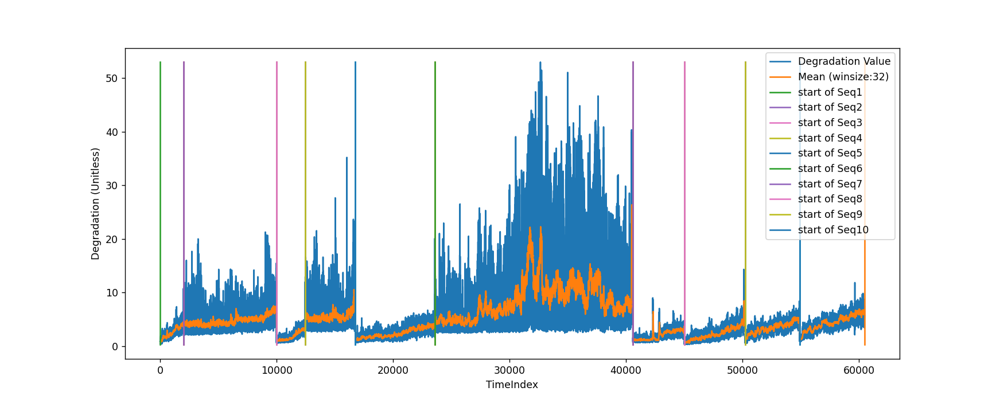

In [48]:
%matplotlib notebook
plt.plot(all_seq_y_tilde_vect, label='Degradation Value')
plt.plot(pd.Series(all_seq_y_tilde_vect).rolling(32).mean(), label='Mean (winsize:32)')

min_y = all_seq_y_tilde_vect.min()
max_y = all_seq_y_tilde_vect.max()


# Type 2 Data
seq_period_iloc = [
    [    0,  1991],
    [ 1991,  9986],
    [ 9986, 12435],
    [ 12435, 16757],
    [ 16757, 23576],
    [ 23576, 40589],
    [ 40589, 45013],
    [ 45013, 50234],
    [ 50234, 54914],
    [ 54914, 60490],
]

seq_index = 1
for stime_iloc, etime_iloc in seq_period_iloc:
    plt.plot([stime_iloc, stime_iloc], [min_y, max_y], label = "start of Seq{}".format(seq_index))
    plt.plot([etime_iloc, etime_iloc], [min_y, max_y])
    seq_index += 1


plt.ylabel("Degradation (Unitless)")
plt.xlabel("TimeIndex")

plt.legend()
plt.show()

In [49]:
import plotly.graph_objects as go

fig = go.Figure()

plot_raw_pts = True
    
fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=all_seq_y_tilde_vect,
        mode='lines',
        name = 'Degradation Metric',
        #mode='lines+markers',
    )
)

fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
        mode='lines',
        name = 'Mean(Windowsize:32)',
        #mode='lines+markers',
    )
)

In [50]:
import plotly.offline as pyo
import plotly.graph_objs as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()
# Create traces
trace0 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=all_seq_y_tilde_vect,
            mode='lines',
            name = 'Degradation Metric',
            #mode='lines+markers',
            )

trace1 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
            mode='lines',
            name = 'Mean(Windowsize:32)',
            #mode='lines+markers',
            )

# Fill out data with our traces
data = [trace0, trace1]
# Plot it and save as basic-line.html
pyo.iplot(data, filename = 'basic-line')

## To see the intmediate feature

In [ ]:
feature_output1 = model.feature_extractor.featuremap1.transpose(1,0).cpu()
feature_output2 = model.feature_extractor.featuremap2.transpose(1,0).cpu()
feature_output3 = model.feature_extractor.featuremapfc.transpose(1,0).cpu()
#feature_output4 = model.model.featuremap4.transpose(1,0).cpu()
#feature_output_fc = model.model.featuremapfc.transpose(1,0).cpu()
feature_output3.shape

In [51]:
def feature_imshow(inp, title=None):
    
    """Imshow for Tensor."""
    
    inp = inp.detach().numpy().transpose((2, 1, 0))
    
    mean = np.array([0.5, 0.5, 0.5])
    
    std = np.array([0.5, 0.5, 0.5])
    
    inp = std * inp + mean
    
    inp = np.clip(inp, 0, 1)
    plt.figure(figsize=(5,5))
    plt.imshow(inp)
    
    if title is not None:
        plt.title(title)
    
    plt.pause(0.001)  # pause a bit so that plots are updated

In [ ]:
out = torchvision.utils.make_grid(feature_output3)
feature_imshow(out)

In [ ]:
dl = test_dataloaders[1]
refs = refs_list[1]

curr_refs = refs.float().to(device)
num_data = len(dl)
print(num_data)
    
loss_vect = np.zeros(num_data)
var_res_vect= np.zeros(num_data)

y_vect = np.zeros(num_data)
y_tilde_vect = np.zeros(num_data)

dl_iter = iter(dl)

for i in tqdm(range(1)):
    try:
        img,label = next(dl_iter)

    except (StopIteration, TypeError):
        dl_iter = iter(curr_train_dl)
        img,label = next(dl_iter)

    y_vect[i] = label

    img = img.float().to(device)
    
    feature_output3 = model.feature_extractor.featuremapfc.transpose(1,0).cpu()
    
    latent_vector = model.featuremap(img)
    refs_latent_vectors = model.featuremap_refs(curr_refs)
    
    output1 = latent_vector.transpose(1,0).cpu()
    output_refs = refs_latent_vectors.transpose(1,0).cpu()

    y_tilde = metric.detach().cpu().numpy()

    var_res_vect[i] = np.var(y_tilde)

    y_tilde_vect[i] = y_tilde.mean()

    loss_vect[i] = np.abs(label - y_tilde_vect[i])

In [ ]:
out = torchvision.utils.make_grid(output1)
feature_imshow(out)

In [ ]:
out = torchvision.utils.make_grid(output_refs)
feature_imshow(out)

# Load Model und Test by using several Seqs data

In [ ]:
batch_size = 1
test_dataloaders = []
for ds in ds_h5_test: 
    test_dataloader = DataLoader(dataset = ds, batch_size=batch_size, shuffle = False)
    test_dataloaders.append(test_dataloader)

In [ ]:
all_seq_y_tilde_vect = np.zeros(0)
time_ids = []

for refs,dl in zip(refs_list, test_dataloaders):

    curr_refs = refs
    curr_refs = [ref.float().to(device) for ref in curr_refs]
    
    num_data = len(dl)
    print(num_data)
    
    loss_vect = np.zeros(num_data)
    var_res_vect= np.zeros(num_data)

    y_vect = np.zeros(num_data)
    y_tilde_vect = np.zeros(num_data)
    
    dl_iter = iter(dl)

    for i in tqdm(range(num_data)):
        try:
            img,label = next(dl_iter)

        except (StopIteration, TypeError):
            dl_iter = iter(curr_train_dl)
            img,label = next(dl_iter)
            
        y_vect[i] = label
        
        img = img.float().to(device)
                
        #targets = targets.float().to(device)
        
        v1, refs_v = model.forward_test(img, curr_refs)
        metric = degradation_metrics(v1,refs_v)
        
        y_tilde = metric.detach().cpu().numpy()

        var_res_vect[i] = np.var(y_tilde)

        y_tilde_vect[i] = y_tilde.mean()

        loss_vect[i] = np.abs(label - y_tilde_vect[i])
        
    time_ids.append(y_tilde_vect.size)
        
    all_seq_y_tilde_vect = np.concatenate((all_seq_y_tilde_vect, y_tilde_vect))

In [ ]:
fig = go.Figure()

fig = go.Figure()

plot_raw_pts = True
    
fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=all_seq_y_tilde_vect,
        mode='lines',
        #mode='lines+markers',
    )
)

fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
        mode='lines',
        #mode='lines+markers',
    )
)